# Study of the possibility to correct the background 
phantom = vertebrae + water + salt + 15ml soap

In [18]:
import numpy as np
import matplotlib.pyplot as plt
import cmath
import nibabel as nib
import cv2
from sklearn.linear_model import LinearRegression 
import scipy
from skimage.restoration import unwrap_phase
from scipy.io import savemat
from scipy.ndimage import gaussian_filter
from skimage.transform import rescale as resc
from skimage.transform import downscale_local_mean
import nibabel as nib
from matplotlib.gridspec import GridSpec
import matplotlib.gridspec as gridspec
from PIL import Image
from scipy import stats
import tqdm
import tikzplotlib

In [19]:
### parameters and constants
TE1=3.06*0.001 #s
TE2=4.08*0.001 #s
delta_TE=TE2-TE1
gamma = 2.675221900e8 # /s/T

In [20]:
def mask(path_mag1, material, tresh, plot=True, slice=71):
    '''
    Return a mask with 0 if inside the compound and 1 outside

    Parameters
    ----------
    path_mag1 : str
        path to the magnitude 1 of the compound.
    material : str
        description of the compound.
    tresh : float
        magnitude treshold of the mask.
    plot : bool, optional
        if true, plot a slice of the magnitude and of the mask. The default is True.
    slice : int, optional
        the slice to plot. The default is 71.

    Returns
    -------
    mask : numpy.ndarray
        mask of the compound.

    '''
    ######## magnitude #############
    mag1 = nib.load(path_mag1)
    data_mag1=mag1.get_fdata() #extract matrix with values
    
    mask = data_mag1 > tresh #return array of booleens
    
    
    #plot the selected slice 
    if plot==True:
        plt.figure(figsize=(8,5))
        plt.subplot(1,2,1)
        plt.imshow(data_mag1[:,:,slice])
        plt.colorbar()
        plt.title(f'Magnitude_1 of {material}')
    
        plt.subplot(1,2,2)
        plt.imshow(mask[:, :, slice])
        plt.colorbar()
        plt.title(f'mask of {material}')
    
        plt.tight_layout()
    #return matrix of delta_B
    return mask

Load the data:

In [21]:
path_mag1_vertebrae = r"FM_1_0MM_VERTEBRAS_SOAP15ML_0024_fm_1.0mm_vertebras_soap15ml_20221118144958_24_e1.nii.gz"
path_phase_vertebrae = r"FM_1_0MM_VERTEBRAS_SOAP15ML_0025_fm_1.0mm_vertebras_soap15ml_20221118144958_25_e2_ph.nii.gz"

path_mag1_water = r"FM_1_0MM_WATER_SOAP15ML_0021_fm_1.0mm_water_soap15ml_20221118144958_21_e1.nii.gz"
path_phase_water = r"FM_1_0MM_WATER_SOAP15ML_0022_fm_1.0mm_water_soap15ml_20221118144958_22_e2_ph.nii.gz"

In [22]:
def rescale(path_mag1, path_phase, material, deltaTE=delta_TE, slice=80, masking=True):
    '''
    Rescale the acquired phase difference to a field map in Hz.
    
    Rescale from the phase difference in 2^13 bits to a field map in Hz, and plot the magnitude, phase difference and field map.
    If masking = True then put values inside the compound at zero.


    Parameters
    ----------
    path_mag1 : str
        path to the first magnitude.
    path_phase : str
        path to the phase difference.
    material : str
        description of the compound.
    deltaTE : float
        TE2-TE1.
    slice : int, optional
        Slice to plot. The default is 80.
    masking : bool, optional
        apply the mask of the magnitude to the field map. The default is True.

    Returns
    -------
    data_phase : numpy.ndarray
        rescaled field map in Hz.

    '''
    ######## magnitude #############
    data_mag1=nib.load(path_mag1).get_fdata() #extract matrix with values of magnitude 1
    
    #plot the selected slice of the magnitude
    plt.figure('f{material}', figsize=(10,4))
    plt.subplot(1,2,1)
    plt.imshow(data_mag1[:,:,slice])
    plt.colorbar()
    plt.title(f'Magnitude_1 of {material}')
    
    
    ########### phase difference and field map ############
    data_phase = nib.load(path_phase).get_fdata() #extract matrix with values
    
    #rescaling:
    data_phase *= np.pi/4096 #set the phase between -pi and pi
    data_phase /= (deltaTE*2*np.pi) #in Hz
    #data_phase /= gamma # in T
    
    # apply the mask if needed
    if masking==True:
        maske=mask(path_mag1, material, 400, plot=False, slice=slice)
        data_phase *= maske
    
    
    #plot the selected slice of field map
    plt.subplot(1,2,2)
    plt.imshow(data_phase[:,:,slice])
    plt.colorbar()
    plt.title(f'Field map (Hz) of {material}')
    plt.show()
    
    plt.tight_layout()
    
    return data_phase 

delta_B_water = rescale(path_mag1_water, path_phase_water, "water", delta_TE, masking=True)
delta_B_vertebrae = rescale(path_mag1_vertebrae, path_phase_vertebrae, "vertebrae", delta_TE, masking=True, slice=80)


Define the center of the vertebrae:

In [23]:
########### center of the vertebrae #############

x_C4 = 78
x_C5 = 60
x_C3 = 95
y = 107
z = 77


dx=40 #35
dy=40 #35
dz=40 #30


slice_z = 38
slice_x = 38

##################################################

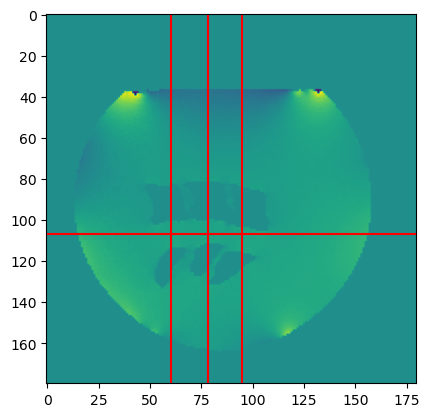

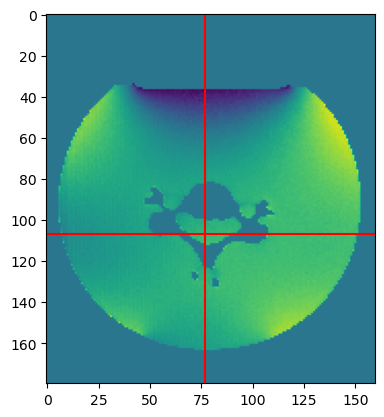

In [24]:
plt.figure()
plt.imshow(delta_B_vertebrae[:,:,80])
plt.axvline(x=x_C5, c='r')
plt.axvline(x=x_C4, c='r')
plt.axvline(x=x_C3, c='r')

plt.axhline(y=y, c='r')
plt.show()

plt.figure()
plt.imshow(delta_B_vertebrae[:,x_C4,:])
plt.axvline(x=z, c='r')
plt.axhline(y=y, c='r')

The B0 axis is the horizontal axis ( ----> )
We need to rotate the ball to have the B0 axis in the normal axis 
90° clock

In [25]:
def rotation90clock(A):
    """
    Rotate a 3D array 90 degrees clockwise around the B0 axis. 
    
    Parameters:
    -----------
    A : numpy.ndarray
        A 3D array of shape (m, n, p).
        
    Returns:
    --------
    A_new : numpy.ndarray
        A 3D array of shape (m, p, n) obtained by rotating A 90 degrees clockwise.
        
    """
    m,n,p = np.shape(A)
    A_new=np.zeros((m,p,n))
    for i in range(m):
        for j in range(n):
            for k in range(p):
                A_new[i, k, n-j-1]=A[i,j,k] 
                
    plt.figure(figsize=(7,3))
    plt.subplot(1,2,1)
    plt.imshow(A[:,:,int(p/2)])
    plt.colorbar()
    plt.title("before rotation")
    
    plt.subplot(1,2,2)
    plt.imshow(A_new[:,:,int(p/2)])
    plt.colorbar()
    plt.title('after rotation')
    
    return A_new

In [26]:
def rescaling_FOV(field_map, x, y, z, dx=dx, dy=dy, dz=dz):
    '''
    Reshape field_map to a smaller array

    Create a new smaller matrix of volume 2dx*2dy*2dz with values recentered on x,y,z
    Attention: x is the second component and y the first one.

    Parameters
    ----------
    field_map : numpy.ndarray
        3D array pf the FM to reshape.
    x : int
        x coordinate around which field_map will be reshaped
    y : int
        y coordinate around which field_map will be reshaped
    z : int
        z coordinate around which field_map will be reshaped
    dx : int, optional
        0.5*width along the x direction of the reshaped matrix. The default is dx.
    dy : int, optional
        0.5*width along the y direction of the reshaped matrix. The default is dy.
    dz : int, optional
        0.5*width along the z direction of the reshaped matrix. The default is dz.
            
    Returns
    -------
    rescaled_matrix : numpy.ndarray
        Reshaped 3D array.

    '''
    
    rescaled_matrix= field_map[y-dy:y+dy, x-dx:x+dx, z-dz: z+dz] 
   
    return rescaled_matrix

Define and rotate the mask:

(180, 180, 160)


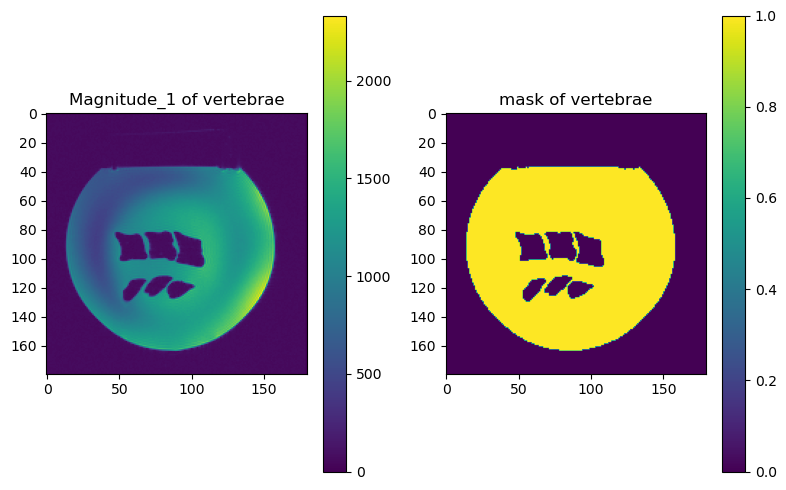

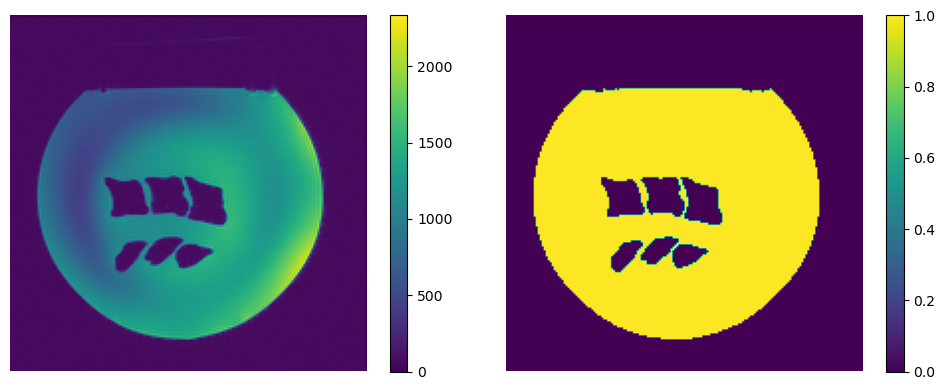

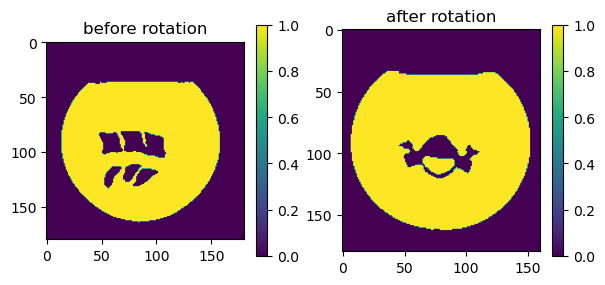

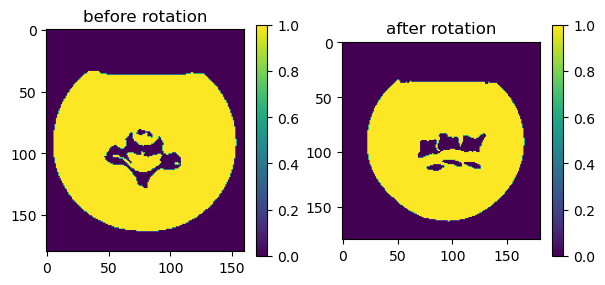

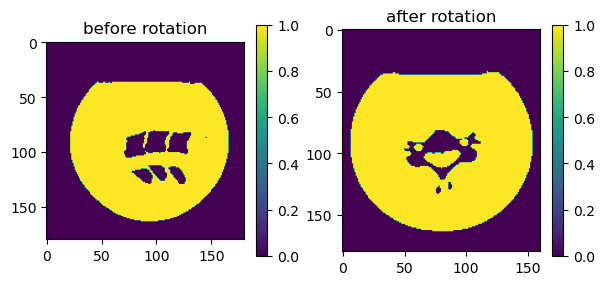

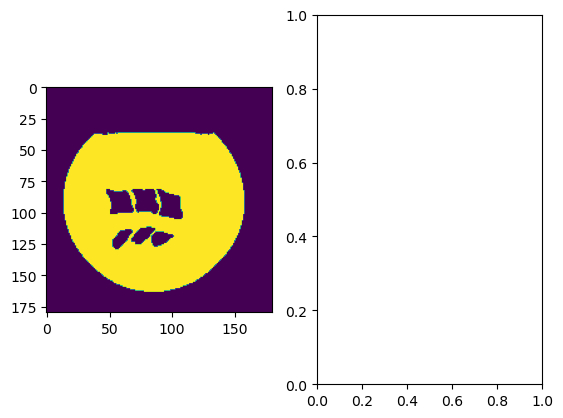

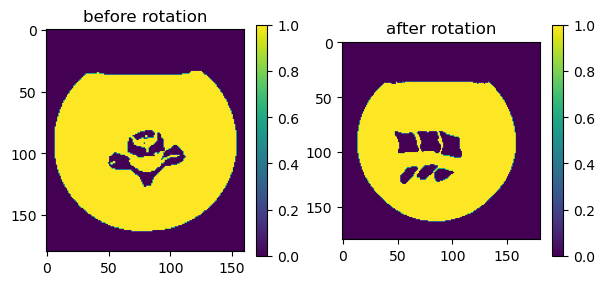

In [27]:
mask_vertebrae = mask(path_mag1_vertebrae, 'vertebrae', 400, plot=True, slice=z)

plt.figure(figsize=(10,4))
plt.subplot(121)
data_mag_vert=nib.load(path_mag1_vertebrae).get_fdata() #extract matrix with values of magnitude 1
plt.imshow(data_mag_vert[:,:,z])
plt.colorbar()
plt.axis('off')
plt.subplot(122)
plt.imshow(mask_vertebrae[:,:,z])
plt.colorbar()
plt.axis('off')
plt.tight_layout()



mask_rotated = (rotation90clock(rotation90clock(rotation90clock(mask_vertebrae)))) #we do 3 rotations so it will come back to normal wih\th one rotation same to the one we did on the ball

plt.figure()
plt.subplot(1,2,1)
plt.imshow(mask_vertebrae[:,:,z])
plt.subplot(1,2,2)
plt.imshow(rotation90clock(mask_rotated)[:,:,z])
mdic = {"mask_fm_rot": mask_rotated, "label": "mask_vertebrae_rotated"}
#savemat("matlab_mask_vertebrae_rotated.mat", mdic)


mdic = {"mask_fm": mask_vertebrae, "label": "mask_vertebrae"}
#savemat("matlab_mask_vertebrae.mat", mdic)
print(np.shape(mask_vertebrae))

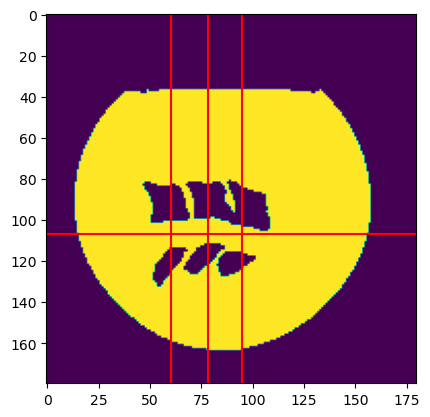

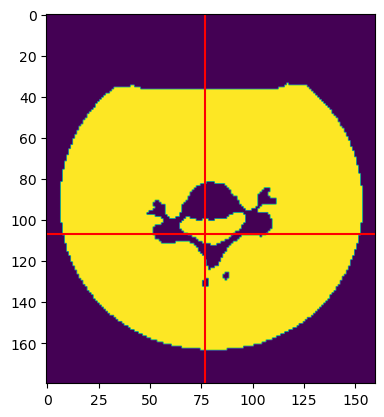

In [28]:

plt.figure()
plt.imshow(mask_rotated[:,160-z,:])
plt.axvline(x=x_C5, c='r')
plt.axvline(x=x_C4, c='r')
plt.axvline(x=x_C3, c='r')

plt.axhline(y=y, c='r')
plt.show()

plt.figure()
plt.imshow(mask_rotated[:,:,x_C4])
plt.axvline(x=z, c='r')
plt.axhline(y=y, c='r')

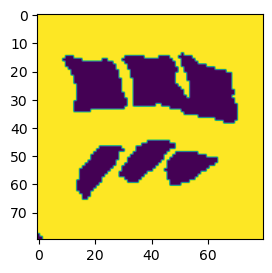

In [29]:
test = rescaling_FOV(mask_rotated, x=160-z, y=y, z=x_C4, dx=dx, dy=dy, dz=dz)

plt.figure()
plt.subplot(1,2,1)
plt.imshow(test[:,40,:])

### Trying to correct the background

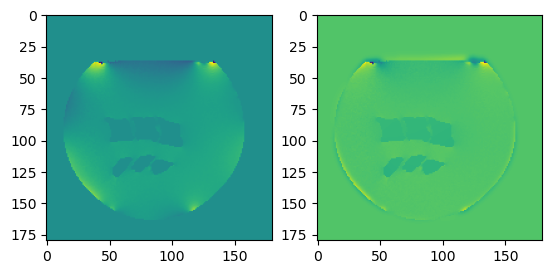

In [30]:
fm_complete= delta_B_vertebrae - gaussian_filter(delta_B_water, sigma=2) # correct with removing the smoothed reference background

plt.figure()
plt.subplot(1,2,1)
plt.imshow(delta_B_vertebrae[:,:,z])
plt.subplot(1,2,2)
plt.imshow(fm_complete[:,:,z])

Comparing the corrected and uncorrected FMs:

(80, 80, 80)


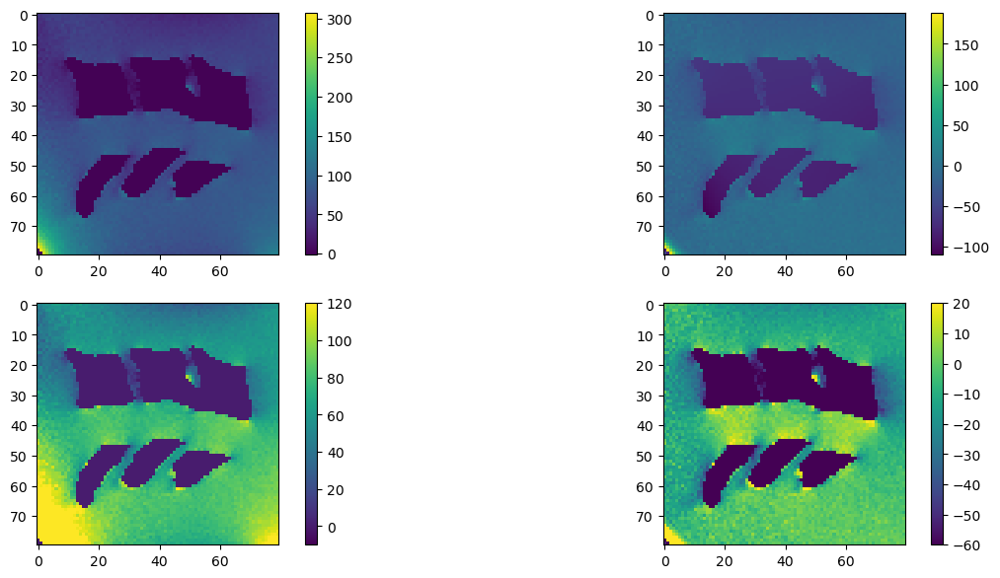

In [31]:
fm=rescaling_FOV(fm_complete, x_C4, y, z)
#fm=fm_complete[74:142, 40:118, 39:121] #fm rescaled, background corrected

delta_B_nocorrection = rescaling_FOV(delta_B_vertebrae, x_C4, y, z)
#delta_B_nocorrection = delta_B_vertebrae[74:142, 40:118, 39:121]#fm rescaled no background rescaled

mask_reshaped = rescaling_FOV(mask_vertebrae, x_C4, y, z)
#mask_reshaped = mask_vertebrae[74:142, 40:118, 39:121]

plt.figure(figsize=(15,7))
plt.subplot(2,2,1)
plt.imshow(delta_B_nocorrection[:,:,slice_z])
plt.colorbar()
plt.subplot(2,2,2)
plt.imshow(fm[:,:,slice_z])
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(delta_B_nocorrection[:,:,slice_z], vmin=-10, vmax=120)
plt.colorbar()
plt.subplot(2,2,4)
plt.imshow(fm[:,:,slice_z], vmin=-60, vmax=20)
plt.colorbar()

print(np.shape(fm))

If we correct using a linear gradient to correct instead of the refernece background :

In [40]:
def calcul_gradient_3D(fm, mask, mode='normal'):
    """
    Calculate the gradients of a 3D image along the x, y, and z axes. 
    
    If mode='linear', calculate the linear gradients instead.

    Parameters
    ----------
    field_map : numpy.ndarray
        3D array with want to compute the gradients of.
    mask : numpy.ndarray
        3D array mask of the FM.
    mode : str, optional
        mode of calculation. Can be 'normal' or 'linear'. The default is 'normal'
        
   Returns
    -------
    (y_grad, x_grad, z_grad) : tuple of numpy ndarrays
        The gradient along the y, x, and z axes.

    """
    

    
    m,n,p = np.shape(fm)
    X_abs = [i for i in range(p)]
    X_abs = np.array(X_abs)

    # gradient z axis
    z_grad = []
    for i in range(p):
        s_avg = np.average(fm[:,:,i], weights=mask[:,:,i])
        z_grad.append(s_avg)
    
    # gradient x axis (horizontal)
    x_grad = []
    for i in range(n):
        s_avg = np.average(fm[:,i,:], weights=mask[:,i,:])
        x_grad.append(s_avg)

    # gradient y axis (vertical)
    y_grad = []
    for i in range(m):
        s_avg = np.average(fm[i,:,:], weights=mask[i,:,:])
        y_grad.append(s_avg)
 
    
    plt.figure()       
    plt.plot(X_abs, z_grad, label='z_axis')
    plt.plot(X_abs, x_grad, label='horizontal')
    plt.plot(X_abs, y_grad, label='vertical')
    
    
    
    if mode=='linear':
        res_z = scipy.stats.linregress(X_abs, z_grad)
        res_x = scipy.stats.linregress(X_abs, x_grad)
        res_y = scipy.stats.linregress(X_abs, y_grad)
        z_grad = res_z.intercept + res_z.slope*X_abs
        x_grad=res_x.intercept + res_x.slope*X_abs
        y_grad = res_y.intercept + res_y.slope*X_abs
        plt.plot(X_abs, res_z.intercept + res_z.slope*X_abs, label='z')
        plt.plot(X_abs, res_x.intercept + res_x.slope*X_abs, label='x')
        plt.plot(X_abs, res_y.intercept + res_y.slope*X_abs, label='y')
    plt.legend()

    return(y_grad, x_grad, z_grad)

def correct_grad3D(fm, mask, y_grad, x_grad, z_grad):
    """
    Correct for 3D gradient artifacts in a 3D image.
        
    Parameters
    ----------
    fm : numpy.ndarray
        3D array with want to correct.
    mask : numpy.ndarray
        3D array mask of the FM.
    y_grad : numpy.ndarray
        1D gradient along the y-axis
    x_grad : numpy.ndarray
        1D gradient along the x-axis
    z_grad : numpy.ndarray
        1D gradient along the z-axis
        
   Returns
    -------
    fm_exp_gradcorrected*mask : numpy ndarray
        3D array of the corrected FM
    """    
    
    m,n,p=np.shape(fm)
    fm_exp_gradcorrected = np.zeros((m,n,p))
    for i in range(m):
        for j in range(n):
            for k in range(p):
                fm_exp_gradcorrected[i,j,k] = fm[i,j,k] - y_grad[i] -x_grad[j] - z_grad[k]
    plt.figure(figsize=(10,4))
    plt.subplot(1,2,1)         
    plt.imshow(fm[:,:,40])
    plt.colorbar()
    plt.subplot(1,2,2)         
    plt.imshow((fm_exp_gradcorrected*mask)[:,:,40])
    plt.colorbar()
    
    return fm_exp_gradcorrected*mask


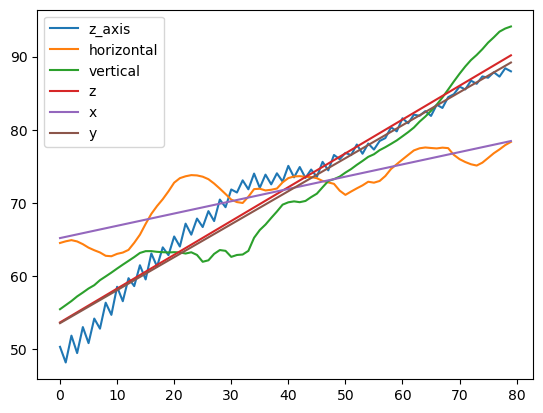

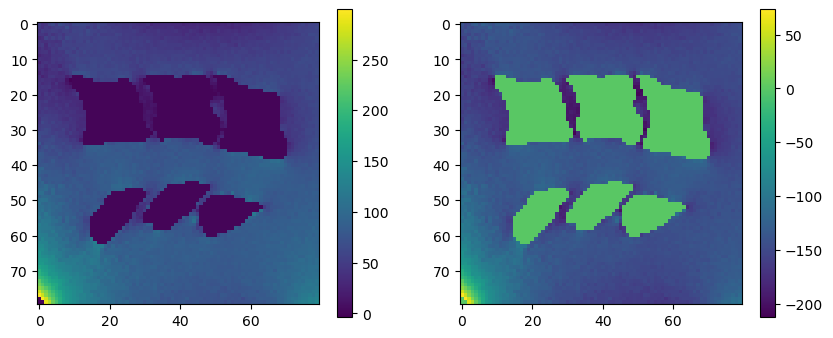

In [41]:
y_grad, x_grad, z_grad= calcul_gradient_3D(delta_B_nocorrection, mask_reshaped, mode='linear')
fm_c1_linear = correct_grad3D(delta_B_nocorrection,mask_reshaped, y_grad, x_grad, z_grad)

We recenter the image by removing the mean background value, and compare the methods

The average background of the fm with vertebrae, backgound corrected, is -5.251299546132313
The average background of the fm with vertebrae, no correction, is 71.72999221763824
The average background of the fm with vertebrae, backgound linearly corrected, is -143.41218442895072


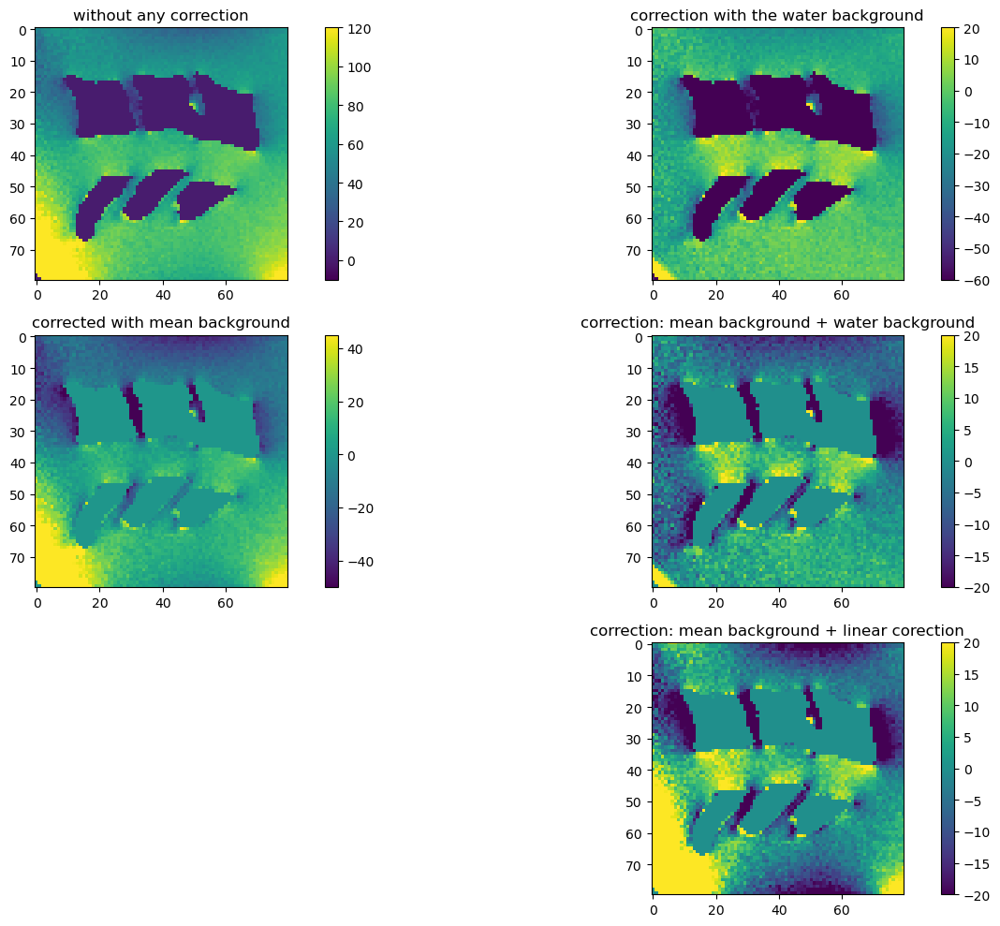

Same but with gaussian filter sigma = 0.5


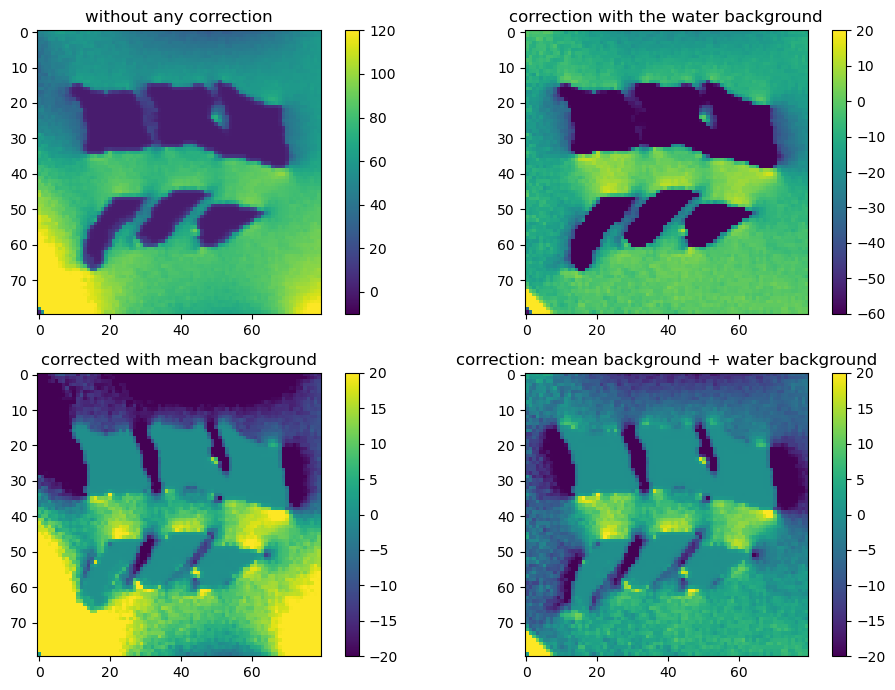

In [42]:
avg_backg = np.average(fm, weights = mask_reshaped)
print(f'The average background of the fm with vertebrae, backgound corrected, is {avg_backg}')

avg_backg_withoutcorrection = np.average(delta_B_nocorrection, weights = mask_reshaped)
print(f'The average background of the fm with vertebrae, no correction, is {avg_backg_withoutcorrection}')

avg_backg_linear = np.average(fm_c1_linear, weights = mask_reshaped)
print(f'The average background of the fm with vertebrae, backgound linearly corrected, is {avg_backg_linear}')



fm_final_corrected = (fm - avg_backg)*mask_reshaped
fm_final_withoutcorrection = (delta_B_nocorrection - avg_backg_withoutcorrection)*mask_reshaped
fm_final_linear = (fm_c1_linear - avg_backg_linear)*mask_reshaped

plt.figure(figsize=(15,10))
plt.subplot(3,2,1)
plt.imshow(delta_B_nocorrection[:,:,slice_z], vmin=-10, vmax=120)
plt.title('without any correction')
plt.colorbar()
plt.subplot(3,2,2)
plt.title('correction with the water background')
plt.imshow(fm[:,:,slice_z], vmin=-60, vmax=20)
plt.colorbar()

plt.subplot(3,2,3)
plt.title('corrected with mean background')
plt.imshow(fm_final_withoutcorrection[:,:,slice_z], vmin=-50, vmax=45)
plt.colorbar()
plt.subplot(3,2,4)
plt.imshow(fm_final_corrected[:,:,slice_z], vmin=-20, vmax=20)
plt.title('correction: mean background + water background')
plt.colorbar()

plt.subplot(3,2,6)
plt.imshow(fm_final_linear[:,:,slice_z], vmin=-20, vmax=20)
plt.title('correction: mean background + linear corection')
plt.colorbar()

plt.tight_layout()
plt.show()


############################### add a gaussian filter #################################
sigma= 0.5
print(f'Same but with gaussian filter sigma = {sigma}')
plt.figure(figsize=(10,7))
plt.subplot(2,2,1)
plt.imshow(gaussian_filter(delta_B_nocorrection, sigma=sigma)[:,:,slice_z], vmin=-10, vmax=120)
plt.title('without any correction')
plt.colorbar()
plt.subplot(2,2,2)
plt.title('correction with the water background')
plt.imshow(gaussian_filter(fm, sigma=sigma)[:,:,slice_z], vmin=-60, vmax=20)
plt.colorbar()

plt.subplot(2,2,3)
plt.title('corrected with mean background')
plt.imshow(gaussian_filter(fm_final_withoutcorrection, sigma=sigma)[:,:,slice_z], vmin=-20, vmax=20)
plt.colorbar()
plt.subplot(2,2,4)
plt.imshow(gaussian_filter(fm_final_corrected, sigma=sigma)[:,:,slice_z], vmin=-20, vmax=20)
plt.title('correction: mean background + water background')

plt.colorbar()
plt.tight_layout()
plt.show()



## Background impact:  cleaner 

To have easier names, we rename the different corrected FMs to compare them:

In [43]:
fm_bc_no_correction = delta_B_nocorrection #no correction of the field map
fm_bc_mean_corrected = fm_final_withoutcorrection #no corretion of the gradients, but recentered with the mean value of the matrix subtracted
fm_bc_lineargradient = fm_final_linear # corrected with linear gradients in the three directions and centered with mean value
fm_bc_referencecorrected = fm_final_corrected #corrected with reference background + recentered with mean
fm_bc_reference_smoothed_sigma05 = gaussian_filter(fm_final_corrected, sigma=0.5)
fm_bc_reference_smoothed_sigma1 = gaussian_filter(fm_final_corrected, sigma=1)

One last correcting method: shape functions inspired from the finite element analysis 

In [54]:
def calcgrad(inp):
    """
    Calculated the 3D gradients along the 3 directions based on shape function
    
    Calculate the shape functions, inspired from the finite element analysis,
    and returns a 3D gradients of the inhomogeneitites based on the chosen nodes
    
    Parameters
    ----------
    inp : numpy.ndarray
        3D array with want to correct.
        
   Returns
    -------
    res : numpy ndarray
        3D array of the 3D gradients
    """  
        

    # get the dimensions
    nx, ny, nz = inp.shape
    
    ymax, ymin = 10, 66
    xmin, xmax = 4, 75
    zmin, zmax = 10, 70
    navg = 4
    nodes = []

    nodes.append(np.mean(inp[ ymin, xmin, zmin])) # N0
    nodes.append(np.mean(inp[ ymax, xmin, zmin])) # N1
    nodes.append(np.mean(inp[ ymax, xmax, zmin])) # N2
    nodes.append(np.mean(inp[ ymin, xmax, zmin])) # N3
    nodes.append(np.mean(inp[ ymin, xmin, zmax])) # N4
    nodes.append(np.mean(inp[ ymax, xmin,zmax])) # N5
    nodes.append(np.mean(inp[ ymax,xmax,zmax])) # N6
    nodes.append(np.mean(inp[ ymin, xmax,zmax])) # N7
    print(nodes)

    def calc_field(x):
        i,j,k = x
        N = np.zeros(8)
        N[0] = (1/8) * (1-i) * (1-j) * (1-k) # -1, -1, -1 <-> 0,0,0
        N[1] = (1/8) * (1+i) * (1-j) * (1-k) # 1, -1, -1 <-> 1, 0, 0
        N[2] = (1/8) * (1+i) * (1+j) * (1-k) # 1, 1, -1 <-> 1, 1, 0
        N[3] = (1/8) * (1-i) * (1+j) * (1-k) # -1, 1, -1 <-> 0, 1, 0
        N[4] = (1/8) * (1-i) * (1-j) * (1+k) # -1, -1, 1 <-> 0, 0, 1
        N[5] = (1/8) * (1+i) * (1-j) * (1+k) # 1, -1, 1 <-> 1, 0, 1
        N[6] = (1/8) * (1+i) * (1+j) * (1+k) # 1, 1, 1 <-> 1, 1, 1
        N[7] = (1/8) * (1-i) * (1+j) * (1+k) # -1, 1, 1 <-> 0, 1, 1
        
        return np.sum(nodes*N)
    
    res = inp*0
    for i in range(nx):
        for j in range(ny):
            for k in range(nz):
                res[i, j, k] = calc_field([2*i/(nx-1)-1,
                                          2*j/(ny-1)-1,
                                          2*k/(nz-1)-1])
   
    return res

[25.132123161764703, 52.6577818627451, 51.70036764705881, 79.46537990196079, 70.84865196078431, 59.35968137254901, 87.36404718137254, 99.09237132352939]
The average background of the fm with vertebrae, corrected with shape functions, is 6.145488362587835


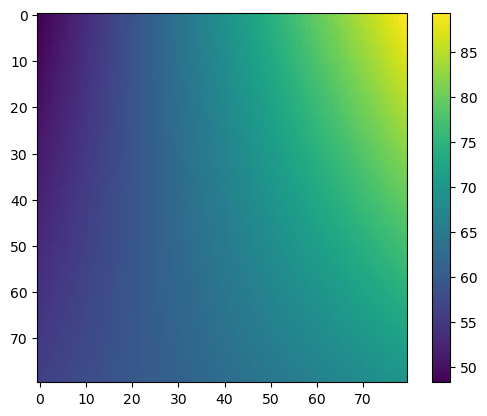

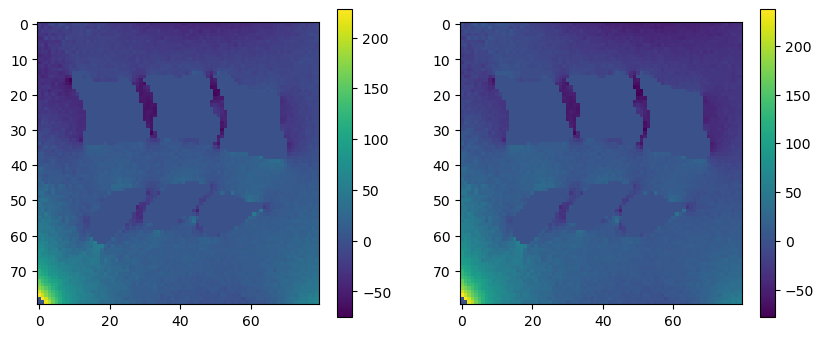

In [55]:
correction_fm = calcgrad(delta_B_nocorrection)
plt.figure()
plt.imshow(correction_fm[:,:,40])
plt.colorbar()

plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.imshow((fm_bc_mean_corrected)[:,:,40])
plt.colorbar()
plt.subplot(1,2,2)
avg_backg_shape_functions = np.average((delta_B_nocorrection-correction_fm), weights = mask_reshaped)
print(f'The average background of the fm with vertebrae, corrected with shape functions, is {avg_backg_shape_functions}')


fm_bc_shapefunction_3D = (delta_B_nocorrection-correction_fm-avg_backg_shape_functions)*mask_reshaped

plt.imshow((fm_bc_shapefunction_3D)[:,:,40])
plt.colorbar()

In [45]:
def calcgrad2(inp):
    """
    Calculated the 2D gradients along the 2 first directions, for each slice, based on shape function
    
    Calculate the shape functions for each slice, inspired from the finite element analysis,
    and returns a 3D gradients of the inhomogeneitites based on the chosen nodes
    
    Parameters
    ----------
    inp : numpy.ndarray
        3D array with want to correct.
        
   Returns
    -------
    res : numpy ndarray
        3D array of each 2D gradients array
    """  
    # get the dimensions
    nx, ny, nz = inp.shape
    ymin, ymax = 1, 66

#     ymax, ymin = 10, 66
    xmin, xmax = 4, 79
    zmin, zmax = 10, 70
    
    navg = 2
    nodes = []

    def calc_field(x):
        i,j,k = x
        # N = np.zeros(8)
        # N[0] = (1/8) * (1-i) * (1-j) * (1-k) # -1, -1, -1 <-> 0,0,0
        # N[1] = (1/8) * (1+i) * (1-j) * (1-k) # 1, -1, -1 <-> 1, 0, 0
        # N[2] = (1/8) * (1+i) * (1+j) * (1-k) # 1, 1, -1 <-> 1, 1, 0
        # N[3] = (1/8) * (1-i) * (1+j) * (1-k) # -1, 1, -1 <-> 0, 1, 0
        # N[4] = (1/8) * (1-i) * (1-j) * (1+k) # -1, -1, 1 <-> 0, 0, 1
        # N[5] = (1/8) * (1+i) * (1-j) * (1+k) # 1, -1, 1 <-> 1, 0, 1
        # N[6] = (1/8) * (1+i) * (1+j) * (1+k) # 1, 1, 1 <-> 1, 1, 1
        # N[7] = (1/8) * (1-i) * (1+j) * (1+k) # -1, 1, 1 <-> 0, 1, 1
               
            
        nodes = []
#         nodes.append(np.mean(inp[0,0,k])) # N0
#         nodes.append(np.mean(inp[-1, 0, k])) # N1
#         nodes.append(np.mean(inp[-1, -1, k])) # N2
#         nodes.append(np.mean(inp[0, -1, k])) # N3
#         nodes.append(np.mean(inp[int(nx/2),0, k])) # N4
#         nodes.append(np.mean(inp[-1,int(ny/2), k])) # N5
#         nodes.append(np.mean(inp[int(nx/2),-1,k])) # N6
#         nodes.append(np.mean(inp[0,int(ny/2),k])) # N7

        nodes.append(np.mean(inp[ymin,xmin,k])) # N0
        nodes.append(np.mean(inp[ymax, xmin, k])) # N1
        nodes.append(np.mean(inp[ymax, xmax, k])) # N2
        nodes.append(np.mean(inp[ymin, xmax, k])) # N3
        nodes.append(np.mean(inp[int(abs((ymin-ymax)/2)),xmin, k])) # N4
        nodes.append(np.mean(inp[ymax,int(abs((xmin-xmax)/2)), k])) # N5
        nodes.append(np.mean(inp[int(abs((ymin-ymax)/2)),xmax,k])) # N6
        nodes.append(np.mean(inp[ymin,int(abs((xmin-xmax)/2)),k])) # N7

        N = np.zeros(8)
        N[0] = -1/4 * (1-i) * (1-j) * (1 + i + j) # -1, -1
        N[1] = -1/4 * (1+i) * (1-j) * (1 - i + j) # 1, -1
        N[2] = -1/4 * (1+i) * (1+j) * (1 - i - j) # 1, 1
        N[3] = -1/4 * (1-i) * (1+j) * (1 + i - j) # -1, 1
        N[4] = 1/2 * (1 - i**2) * (1 - j)         # 0, -1
        N[5] = 1/2 * (1 + i   ) * (1 - j**2)      # 1, 0
        N[6] = 1/2 * (1 - i**2) * (1 + j)         # 0, 1
        N[7] = 1/2 * (1 - i   ) * (1 - j**2)      #-1, 0
        
        return np.sum(nodes*N)
    
    res = inp*0
    for i in range(nx):
        for j in range(ny):
            for k in range(nz):
                res[i, j, k] = calc_field([2*i/(nx-1)-1,
                                           2*j/(ny-1)-1,
                                           k
                                           ])
   
    return res

The average background of the fm with vertebrae, corrected with shape functions calculated on each slice, is 8.804862219802759


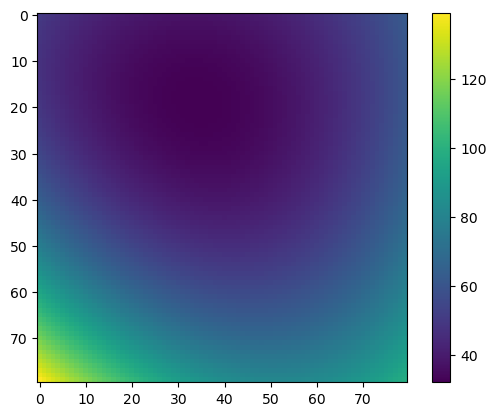

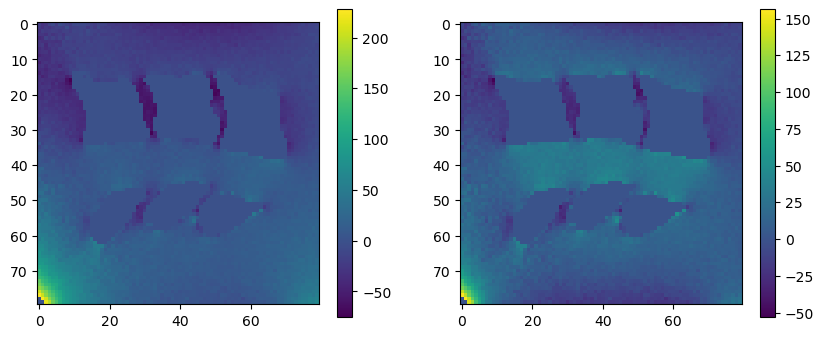

In [46]:
correction_fm2 = calcgrad2(delta_B_nocorrection)
plt.figure()
plt.imshow(correction_fm2[:,:,40])
plt.colorbar()

plt.figure(figsize=(10,4))
plt.subplot(1,2,1)
plt.imshow((fm_bc_mean_corrected)[:,:,40])
plt.colorbar()
plt.subplot(1,2,2)
avg_backg_shape_functions2 = np.average((delta_B_nocorrection-correction_fm2), weights = mask_reshaped)
print(f'The average background of the fm with vertebrae, corrected with shape functions calculated on each slice, is {avg_backg_shape_functions2}')

fm_bc_shapefunction_slice_by_slice = (delta_B_nocorrection-correction_fm2-avg_backg_shape_functions2)*mask_reshaped

plt.imshow(fm_bc_shapefunction_slice_by_slice[:,:,40])
plt.colorbar()

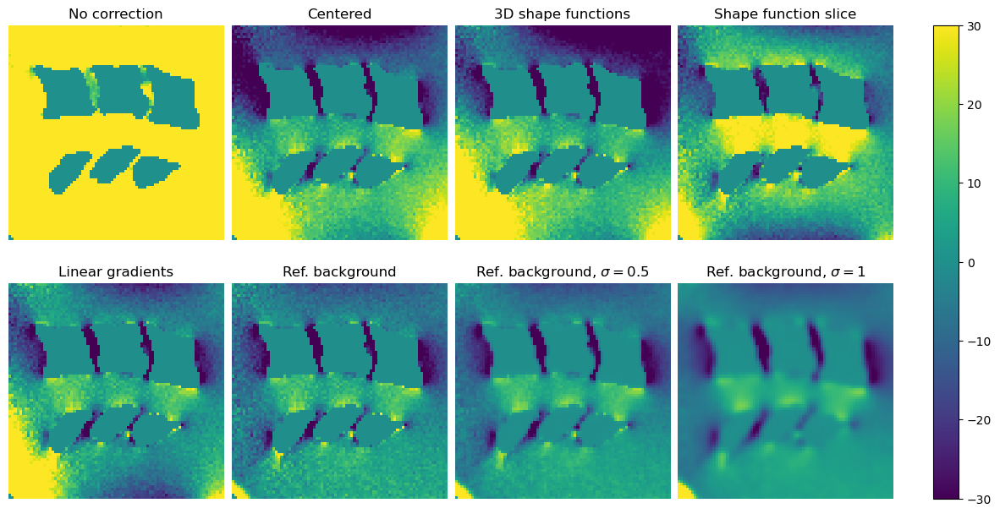

In [56]:
fig, axes = plt.subplots(nrows=2, ncols=4, figsize=(15, 7))

vmin, vmax = -30, 30

axes[0][0].imshow(fm_bc_no_correction[:,:,40], vmin=vmin, vmax=vmax)
axes[0][0].set_title('No correction')
axes[0][0].axis('off')

axes[0][1].imshow(fm_bc_mean_corrected[:,:,40], vmin=vmin, vmax=vmax)
axes[0][1].set_title('Centered')
axes[0][1].axis('off')

axes[0][2].imshow(fm_bc_shapefunction_3D[:,:,40], vmin=vmin, vmax=vmax)
axes[0][2].set_title('3D shape functions')
axes[0][2].axis('off')


axes[0][3].imshow(fm_bc_shapefunction_slice_by_slice[:,:,40], vmin=vmin, vmax=vmax)
axes[0][3].set_title('Shape function slice')
axes[0][3].axis('off')


axes[1][0].imshow(fm_bc_lineargradient[:,:,40], vmin=vmin, vmax=vmax)
axes[1][0].set_title('Linear gradients')
axes[1][0].axis('off')


axes[1][1].imshow(fm_bc_referencecorrected[:,:,40], vmin=vmin, vmax=vmax)
axes[1][1].set_title('Ref. background')
axes[1][1].axis('off')

axes[1][2].imshow(fm_bc_reference_smoothed_sigma05[:,:,40], vmin=vmin, vmax=vmax)
axes[1][2].set_title('Ref. background, $\sigma=0.5$')
axes[1][2].axis('off')


im=axes[1][3].imshow(fm_bc_reference_smoothed_sigma1[:,:,40], vmin=vmin, vmax=vmax)
axes[1][3].set_title('Ref. background, $\sigma=1$')
axes[1][3].axis('off')

fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.2)

# add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
cbar = fig.colorbar(im, cax=cb_ax)
# tikzplotlib.save(r"figures\fig_res_background_correction.tex")

plt.show()
    


## z-Gradients

gradients along the z-directions of the corrected FMs

In [57]:
def gradient_fm_z_doublemask(fm, mask, material='', plot=True, vmin=-50, vmax=50, vmin_fm=-20, vmax_fm=60):
    '''
    Compute the z-gradient of the FM

    Parameters
    ----------
    fm : numpy.ndarray
        3D array of the field map we want to compute the gradient of.
    mask : numpy.ndarray
        3D array of the mask of the FM.
    material : str, otpional
        description of the compound. The default is ''.
    plot : bool, optional
        if True, plot the z-gradient. The default is True.
    vmin : int, optional
        lower limit of the gradient's color scale. The default is -50.
    vmax : int, optional
        higher limit of the gradient's color scale. The default is 50.
    vmin_fm : int, optional
        lower limit of the FM's color scale. The default is -20.
    vmax_fm : int, optional
        higher limit of the FM's color scale. The default is 60.

    Returns
    -------
    gradient : numpy.ndarray
        z-gradient of the FM.

    '''    
    ### correction : we will apply a mask to exclude the vertebrae from both fm and fm_shifted
    mask_shift = np.roll(mask, 1, axis=1)
    maske = mask * mask_shift     
    
    fm_shifted = np.roll(fm, 1, axis=1) # shift from 1 voxel

    # print(np.shape((fm_shifted - fm)))
    gradient = (fm_shifted - fm) * maske
    m,n,p = np.shape(gradient)
    
    if plot==True: 
        plt.figure(figsize=(13,4))
        plt.subplot(1,3,1)
        plt.imshow((fm*mask)[:,:, p//2], vmin=vmin_fm, vmax=vmax_fm)
        plt.colorbar()
        plt.title(f'Field map (Hz) {material}')
        plt.subplot(1,3,2)
        plt.imshow((gradient)[:,1:, p//2], vmin=vmin, vmax=vmax)
        plt.colorbar()
        plt.title(f'Gradient of the fm {material} in the B0 direction')
        plt.subplot(1,3,3)
        plt.imshow(abs(gradient)[:,1:, p//2], vmin=0, vmax=vmax)
        plt.colorbar()
        plt.title(f'absolute gradient of the fm {material} in the B0 direction')
        plt.tight_layout()
    return gradient

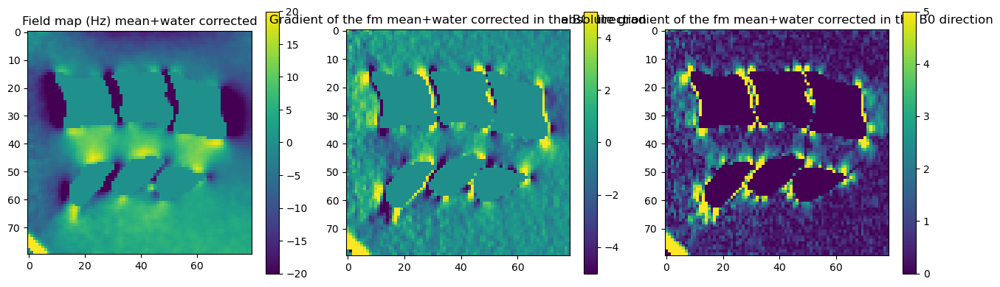

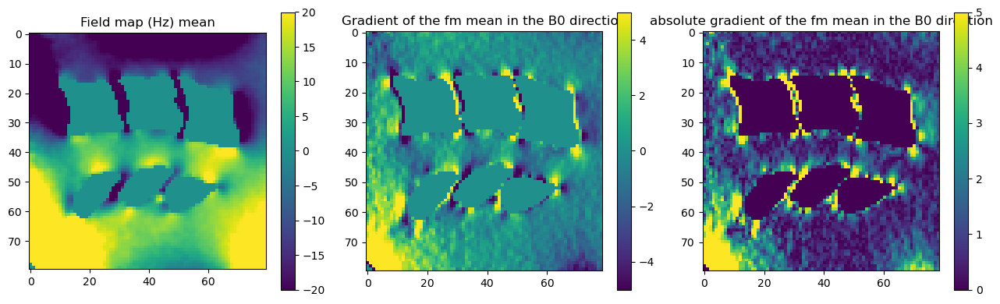

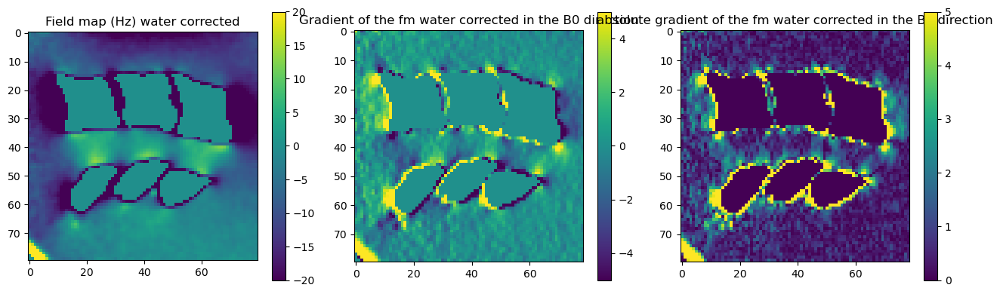

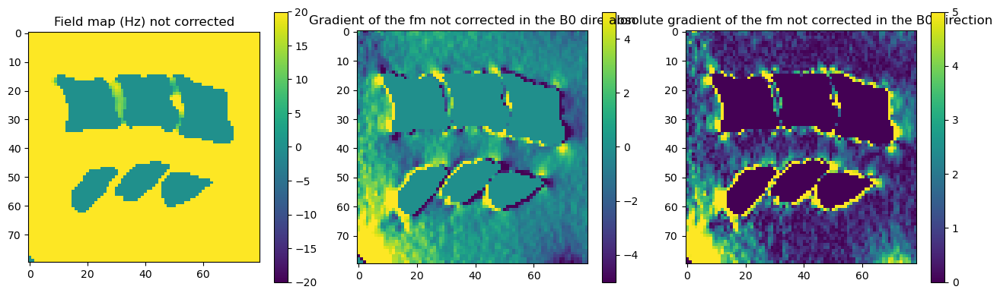

In [58]:
gradient_corr_mean_water = gradient_fm_z_doublemask(gaussian_filter(fm_final_corrected, sigma=0.75), mask_reshaped, material='mean+water corrected', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)
gradient_corr_mean = gradient_fm_z_doublemask(gaussian_filter(fm_final_withoutcorrection, sigma=0.75), mask_reshaped, material='mean', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)
gradient_corr_water = gradient_fm_z_doublemask(gaussian_filter(fm, sigma=0.75), mask_reshaped, material='water corrected', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)
gradient_nocorr = gradient_fm_z_doublemask(gaussian_filter(delta_B_nocorrection, sigma=0.75), mask_reshaped, material='not corrected', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)


## Simulations

We import the simulated FM from Matlab (computed on the previous extracted mask)

In [59]:
maskMoi = scipy.io.loadmat(r"simu-moi/maskMoi.mat")
simuMoi = scipy.io.loadmat(r"simu-moi/simuMoi.mat")

(68, 78, 82)


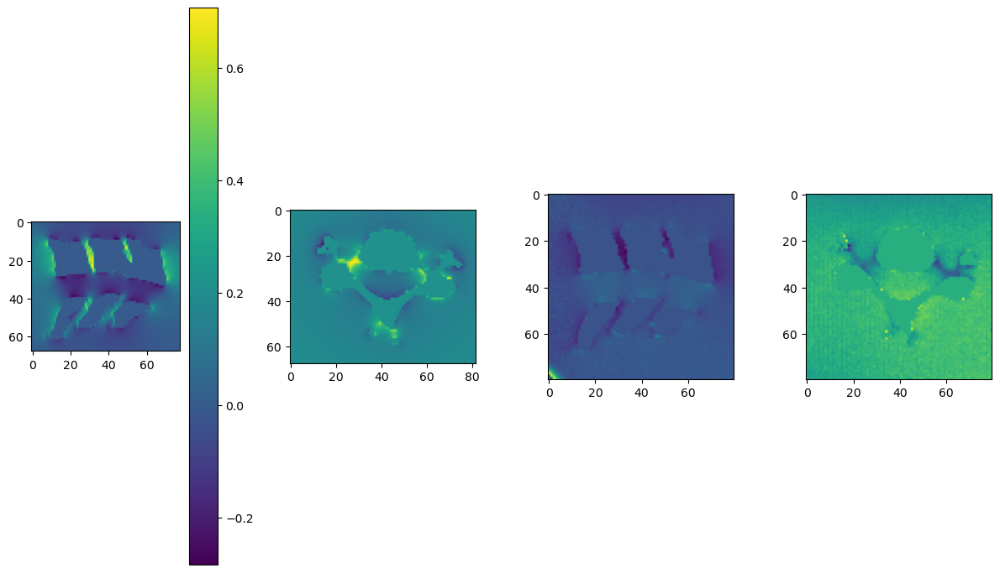

In [60]:
fm_simu_NC = simuMoi['I_sus']
mask_simu = -(maskMoi['I']-1)

fm_simu = fm_simu_NC*mask_simu

plt.figure(figsize=(12,10))
plt.subplot(1,4,1)
plt.imshow(fm_simu[115:183,110:188,108+slice_z].real)
plt.colorbar()

plt.subplot(1,4,2)
plt.imshow(fm_simu[115:183,110+slice_x, 108:190].real)
plt.tight_layout()
# plt.show()
print(np.shape(fm_simu[115:183,110:188,108:190]))


plt.subplot(1,4,3)
plt.imshow(fm_final_corrected[:,:,slice_z])
#plt.colorbar()
plt.subplot(1,4,4)
plt.imshow(fm_final_corrected[:,slice_x,:])

#######################################################################################################
fm_simu_final = fm_simu[109:189,109:189,109:189].real
mask_simu_final = mask_simu[109:189,109:189,109:189].real

#######################################################################################################

let s check if simu and exp are well aligned 

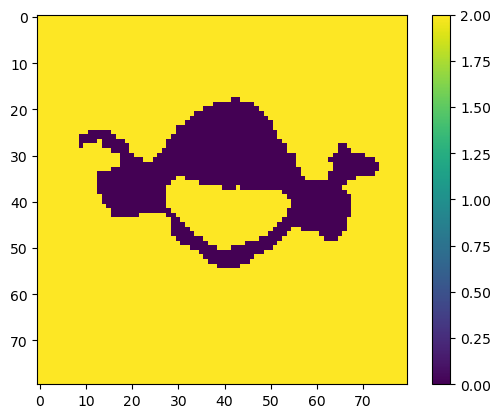

In [61]:
plt.imshow((mask_simu_final+mask_reshaped)[:,:,47])
plt.imshow((mask_simu_final+mask_reshaped)[:,60,:])
plt.colorbar()

## Comparison between simulation and experiment

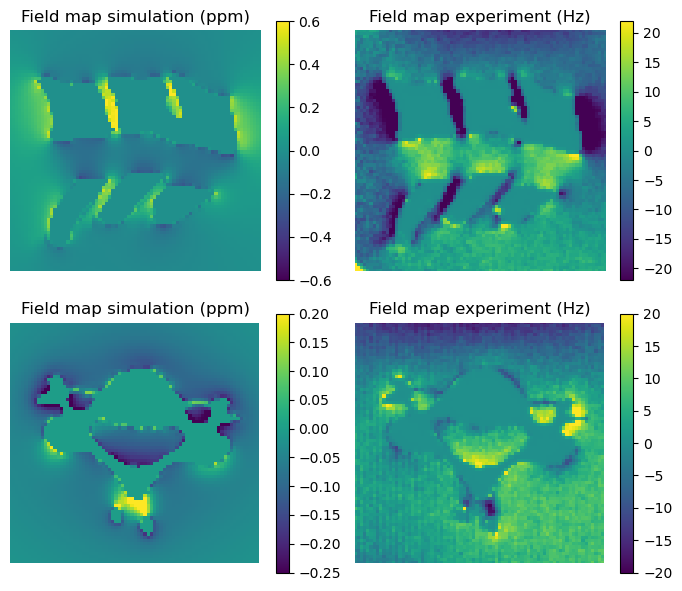

In [62]:
#####################################################
fm_exp_final = gaussian_filter(fm_final_corrected, sigma=0.5) #smooth a bit the field map

####################################################


plt.figure(figsize=(7,6))
ymin, ymax = 0, 75
xmin, xmax = 0, 78

slice = 38

plt.subplot(2,2,1)
plt.imshow(fm_simu_final[:,:,slice], vmin=-0.6, vmax=0.6) #, aspect='auto')
plt.title('Field map simulation (ppm)')
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
plt.colorbar()

plt.subplot(2,2,2)
plt.imshow(fm_exp_final[:,:,slice], vmin=-22, vmax=22)#, aspect='auto')
plt.title('Field map experiment (Hz)')
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
plt.colorbar()

plt.subplot(2,2,3)
plt.imshow(fm_simu_final[:,slice+3,:], vmin=-0.25, vmax=0.2) #, aspect='auto')
plt.title('Field map simulation (ppm)')
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin+2,xmax+2)
plt.colorbar()

plt.subplot(2,2,4)
plt.imshow(fm_exp_final[:,slice+3,:], vmin=-20, vmax=20)#, aspect='auto')
plt.title('Field map experiment (Hz)')
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin+2,xmax+2)
plt.colorbar()

plt.tight_layout()
plt.show()
    

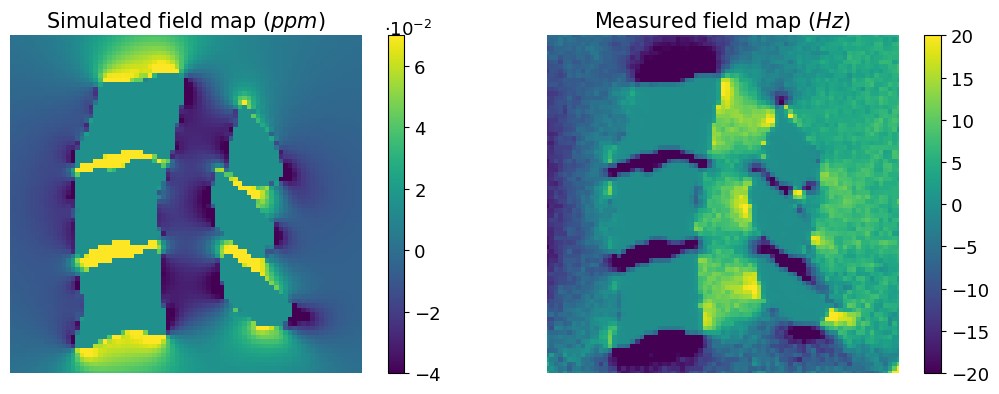

In [63]:
vmin=-4
vmax = 7

mask_offset = -(mask_simu_final-1)*(vmin+vmax)/2
fm_simu_final_x100_off = fm_simu_final*20+mask_offset # this is just to change the value inside the vertebrae
fm_simu_final_x100 = fm_simu_final*20



fig=plt.figure(figsize=(11,4))
fig.patch.set_facecolor('white')
ymin, ymax = 0, 75
xmin, xmax = 0, 78

slice = 40

plt.subplot(1,2,1)
# plt.imshow(fm_simu_final_x100_off[:,:,slice], vmin=vmin, vmax=vmax) #, aspect='auto')
plt.imshow(np.transpose(fm_simu_final_x100_off[:,::-1,slice]), vmin=vmin, vmax=vmax) #, aspect='auto')
plt.title('Simulated field map ($ppm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x=83, y=0, s='$\cdot 10^{-2}$', size=13)

plt.subplot(1,2,2)
plt.imshow(np.transpose(fm_exp_final[:,::-1,slice]), vmin=-20, vmax=20)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)


plt.tight_layout()
# plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)

#### letters
#plt.text(x= -107.5 ,y=3, s='a)', size=15)
#plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
plt.show()
    

In [64]:
def linear_reg_simexp(fm_simu1, fm_exp1, mask_simu1, mask_exp1, part, xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_simu)[1], ymax=np.shape(fm_simu)[0], zmax=np.shape(fm_simu)[2]):
    '''
    Calculate the linear regression between `fm_simu1` and `fm_exp1`, excluding the values inside the masks (inside the compound).

    
    The regression between fm_simu1 and fm_exp1 is calculated on the voxels which coordinates are inside [xmin,xmax],[ymin,ymax],[zmin,zmax]
    Attention: x is the second component and y the first one.
    Plot the linear regression, one slice of the simulated and acquired field map and the histogram of the error. 
    
    Parameters
    ----------
    fm_simu1 : np.ndarray
        3D array of the simulated FM.
    fm_exp1 : np.ndarray
        3D array of the acquired FM.
    mask_simu1 : np.ndarray
        3D array of the simulated mask.
    mask_exp1 : np.ndarray
        3D array of the acquired mask.
    part : str
        description of the compound.
    xmin : int, optional
        the minimum x value to use for the regression calculation. The default is 0.
    ymin : int, optional
        the minimum y value to use for the regression calculation. The default is 0.
    zmin : int, optional
        the minimum z value to use for the regression calculation. The default is 0.
    xmax : int, optional
        the maximum x value to use for the regression calculation. The default is np.shape(fm_simu)[1].
    ymax : int, optional
        the maximum y value to use for the regression calculation. The default is nnp.shape(fm_simu)[0].
    zmax : int, optional
        the maximum z value to use for the regression calculation. The default is np.shape(fm_simu)[2].

    Returns
    -------
    result_corrected : scipy.stats._stats_mstats_common.LinregressResult
        A tuple containing the parameters of the regression line.

    '''
  
    ### reshaping to 1D vector
    
    fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    fm_exp=fm_exp1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_simu2=mask_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_exp2=mask_exp1[ymin:ymax, xmin:xmax, zmin:zmax]

    m,n,p = fm_simu.shape
    simu = fm_simu.reshape(m*n*p) #need to have vector 1D to apply the linear regression
    exp = fm_exp.reshape(n*m*p)

    mask_exp = mask_exp2.reshape(m*n*p)
    mask_simu = mask_simu2.reshape(m*n*p)

    exp_corrected = []
    simu_corrected=[]

    for i in range(m*p*n):
        if mask_exp[i]!=0 and mask_simu[i]!=0:
            simu_corrected.append(simu[i])
            exp_corrected.append(exp[i])

    ### regression lineaire
    result_corrected = scipy.stats.linregress(simu_corrected, exp_corrected)
    print(f'######## regression linéaire - {part} ############')
    print(f' fm_exp = {result_corrected.slope} * fm_simu + {result_corrected.intercept} ')
    print(f'R^2 = {result_corrected.rvalue **2}')
    print(f'p-value = {result_corrected.pvalue }')


    #######################"" plot################################
    plt.figure()
    plt.plot(simu_corrected, exp_corrected, '.', c='pink', label=part)
    plt.xlabel('Simulation')
    plt.ylabel('Experiment')
    plt.title(f'Correlation between simulation and experiment on {part}')
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'b')
    plt.legend()
    plt.show()

    
    plt.figure()
    plt.subplot(1,2,1)
    plt.imshow(fm_simu[:,:, int((zmax-zmin)/2)])
    plt.subplot(1,2,2)
    plt.imshow(fm_simu[:, int((xmax-xmin)/2), :])
    plt.show()

    print(np.shape(fm_simu))
    return result_corrected

######## regression linéaire - whole array ############
 fm_exp = -64.89978245788346 * fm_simu + -0.7529988400936971 
R^2 = 0.2978062110894435
p-value = 0.0


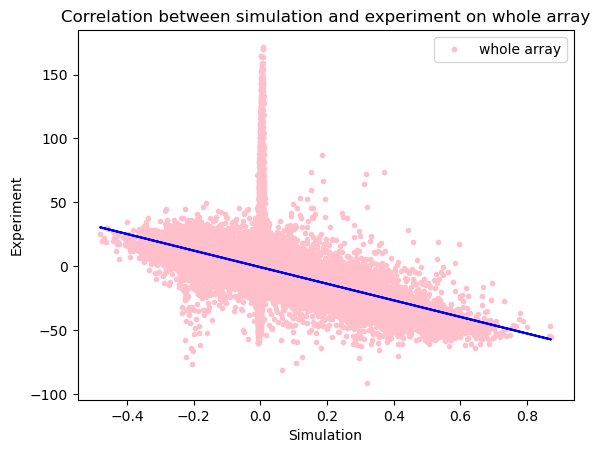

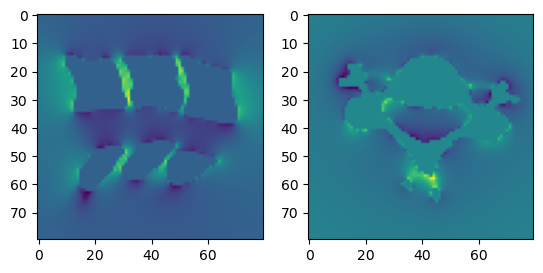

(80, 80, 80)


In [65]:
result_wholearray = linear_reg_simexp(fm_simu1=fm_simu_final, fm_exp1=fm_exp_final, mask_simu1=mask_simu_final, mask_exp1=mask_reshaped, part="whole array", xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_simu_final)[1], ymax=np.shape(fm_simu_final)[0], zmax=np.shape(fm_simu_final)[2])


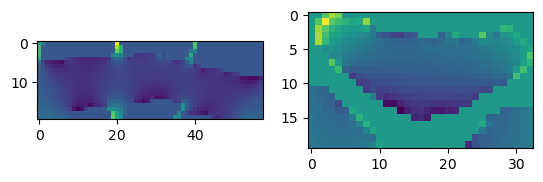

In [66]:
xcmin = 12
xcmax =70
ycmin = 30
ycmax = 50
zcmin = 25
zcmax =58
plt.figure()
plt.subplot(1,2,1)
plt.imshow(fm_simu_final[ycmin:ycmax, xcmin:xcmax, 40])
plt.subplot(1,2,2)
plt.imshow(fm_simu_final[ycmin:ycmax, 40, zcmin:zcmax])

######## regression linéaire - the spinal canal ############
 fm_exp = -73.16509142366647 * fm_simu + -0.8668819513052437 
R^2 = 0.7564081140994561
p-value = 0.0


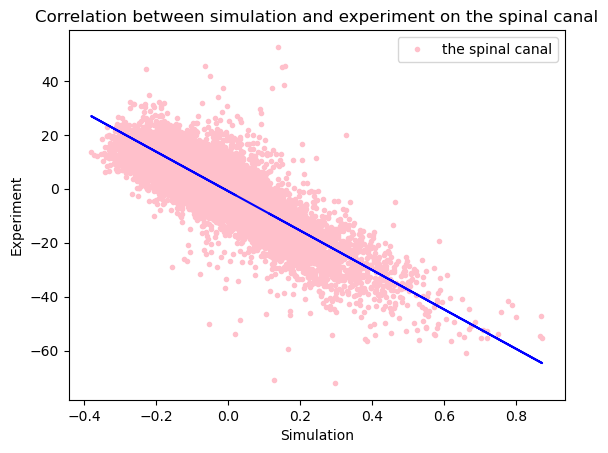

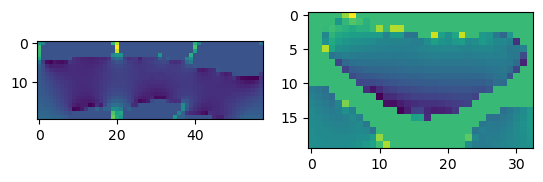

(20, 58, 33)


In [67]:
result_canal = linear_reg_simexp(fm_simu1=fm_simu_final, fm_exp1=fm_exp_final, mask_simu1=mask_simu_final, mask_exp1=mask_reshaped, part="the spinal canal", xmin=xcmin, ymin=ycmin, zmin=zcmin, xmax=xcmax, ymax=ycmax, zmax=zcmax)


## Regression cleaner

In [68]:
def linear_reg_simexp_clean(fm_simu1, fm_exp1, mask_simu1, mask_exp1, part, xmin=0, ymin=0, zmin=0, xmax=np.shape(fm_simu)[1], ymax=np.shape(fm_simu)[0], zmax=np.shape(fm_simu)[2]):
        '''
    Calculate the linear regression between `fm_simu1` and `fm_exp1`, excluding the values inside the masks (inside the compound).

    
    The regression between fm_simu1 and fm_exp1 is calculated on the voxels which coordinates are inside [xmin,xmax],[ymin,ymax],[zmin,zmax]
    Attention: x is the second component and y the first one.
    Plot the linear regression, one slice of the simulated and acquired field map and the histogram of the error. 
    
    Parameters
    ----------
    fm_simu1 : np.ndarray
        3D array of the simulated FM.
    fm_exp1 : np.ndarray
        3D array of the acquired FM.
    mask_simu1 : np.ndarray
        3D array of the simulated mask.
    mask_exp1 : np.ndarray
        3D array of the acquired mask.
    part : str
        description of the compound.
    xmin : int, optional
        the minimum x value to use for the regression calculation. The default is 0.
    ymin : int, optional
        the minimum y value to use for the regression calculation. The default is 0.
    zmin : int, optional
        the minimum z value to use for the regression calculation. The default is 0.
    xmax : int, optional
        the maximum x value to use for the regression calculation. The default is np.shape(fm_simu)[1].
    ymax : int, optional
        the maximum y value to use for the regression calculation. The default is nnp.shape(fm_simu)[0].
    zmax : int, optional
        the maximum z value to use for the regression calculation. The default is np.shape(fm_simu)[2].

    Returns
    -------
    result_corrected : scipy.stats._stats_mstats_common.LinregressResult
        A tuple containing the parameters of the regression line.

    '''
        
    ### reshaping to 1D vector
    
    fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    fm_exp=fm_exp1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_simu2=mask_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
    mask_exp2=mask_exp1[ymin:ymax, xmin:xmax, zmin:zmax]

    m,n,p = fm_simu.shape
    simu = fm_simu.reshape(m*n*p) #need to have vector 1D to apply the linear regression
    exp = fm_exp.reshape(n*m*p)

    mask_exp = mask_exp2.reshape(m*n*p)
    mask_simu = mask_simu2.reshape(m*n*p)

    exp_corrected = []
    simu_corrected=[]

    for i in range(m*p*n):
        if mask_exp[i]!=0 and mask_simu[i]!=0:
            simu_corrected.append(simu[i])
            exp_corrected.append(exp[i])

    ### regression lineaire
    result_corrected = scipy.stats.linregress(simu_corrected, exp_corrected)
    print(f'######## regression linéaire - {part} ############')
    print(f' fm_exp = {result_corrected.slope} * fm_simu + {result_corrected.intercept} ')
    print(f'R^2 = {result_corrected.rvalue **2}')
    print(f'p-value = {result_corrected.pvalue }')


    #######################"" plot################################
    plt.figure()
    plt.plot(simu_corrected[::], exp_corrected[::], '.', c='pink', label=part)
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'black')
    print(plt.xlim())
    print(plt.ylim())
    plt.axis('off')
    plt.savefig(r"figures\correlation_simu_exp_first_vertebral_phantom_test4_reg.png")
    
    plt.figure(figsize=(9,7))
    plt.subplot(221)
    plt.plot(simu_corrected[::4], exp_corrected[::4], '.', c='pink', label=part)
    plt.xlabel('Simulated data (ppm)', size=12)
    plt.ylabel('Measured data (Hz)', size=12)
#     plt.title(f'Correlation acquisition/simulation')
    plt.plot(simu, result_corrected.intercept + result_corrected.slope*simu, 'black')
#     plt.legend()
    
    plt.subplot(223) ## histogram of the error
    approx = np.array([result_corrected.intercept + result_corrected.slope*simu_corrected[i] for i in range(len(simu_corrected))])
    error = exp_corrected - approx #f(xi)-y
    plt.hist(error, bins=75)
    plt.xlabel('$ f(x_i)-y$', size=13)
    plt.ylabel('Number of voxels', size=13)

#     plt.title('Histogram of the error f(xi)-y')
    
    plt.subplot(222)
    slice = int((zmax-zmin)/2)
    slice = 40
    A=fm_simu1[:, :, slice].copy()
    A[ymin,xmin:xmax+1] = 1
    A[ymax,xmin:xmax+1] = 1
    A[ymin:ymax,xmin] = 1
    A[ymin:ymax,xmax] = 1
#     fm_simu=fm_simu1[ymin:ymax, xmin:xmax, zmin:zmax]
#     plt.imshow(np.transpose(fm_simu[:,::-1,slice]))
    plt.imshow(A[:,::-1].T)
#     plt.title('Simulation (ppm)', size=12)
#     plt.colorbar()
    plt.axis('off')

    plt.subplot(224)
    slice=40
    B=fm_simu1[:, slice, :].copy()
    B[ymin,zmin:zmax+1] = 1
    B[ymax,zmin:zmax+1] = 1
    B[ymin:ymax,zmin] = 1
    B[ymin:ymax,zmax] = 1
    plt.imshow(B, vmax=0.3)
#     plt.imshow(fm_simu[:,int((xmax-xmin)/2), :])    
#     plt.colorbar()
#     plt.title(f'Measurement (Hz)', size=12)
    plt.axis('off')

    plt.tight_layout()
    
#     plt.text(x= -38.45 ,y=-26.4, s='a)', size=15)
#     plt.text(x= -0.8 ,y=-26.4, s='b)', size=15)
#     plt.text(x= -38.45 ,y=-1, s='c)', size=15)
#     plt.text(x= -0.8,y=-1, s='d)', size=15)
#     plt.text(x= -19,y=-20, s='$y = -115.6 \cdot x-8.88$', size=12)
#     tikzplotlib.save(r"figures\correlation_simu_exp_first_vertebral_phantom_test4.tex")
#     plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\tests materiaux\230224_test5_sugar_mouthwash\figures\linearregression_sugar_c1.png", dpi=300)

    plt.show()

    

    
    print(np.shape(fm_simu))
    return result_corrected

######## regression linéaire - spinal canal ############
 fm_exp = -73.16509142366647 * fm_simu + -0.8668819513052437 
R^2 = 0.7564081140994561
p-value = 0.0
(-0.44248236864805224, 0.9343400463461876)
(-78.22180516668055, 58.8070122295882)


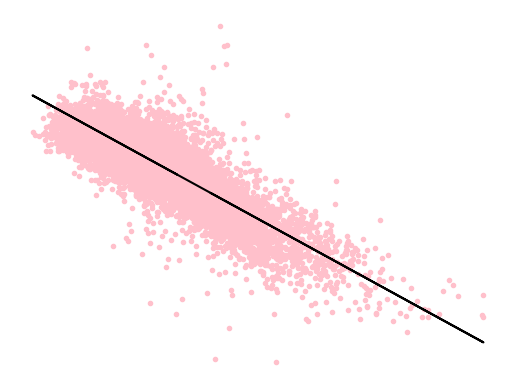

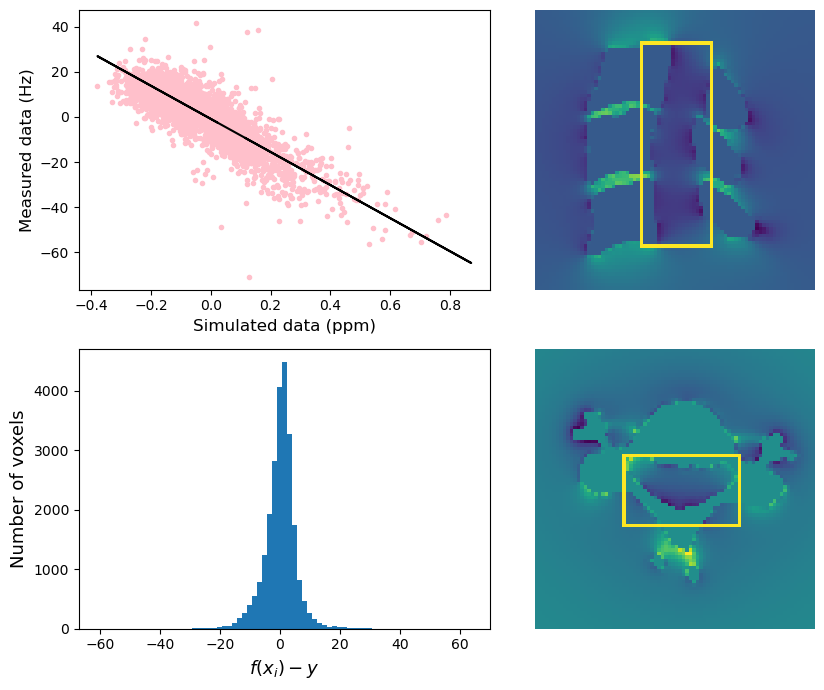

(20, 58, 33)


In [69]:
result_clean_canal = linear_reg_simexp_clean(fm_simu1 = fm_simu_final, fm_exp1 = fm_exp_final, mask_simu1 = mask_simu_final, mask_exp1 = mask_reshaped, part= 'spinal canal', xmin=xcmin, ymin=ycmin, zmin=zcmin, xmax=xcmax, ymax=ycmax, zmax=zcmax)

### Lets try to correct with the susceptibility values obtained with the balls

In [70]:
fm_simu_final_corrected = fm_simu_final*(-84)

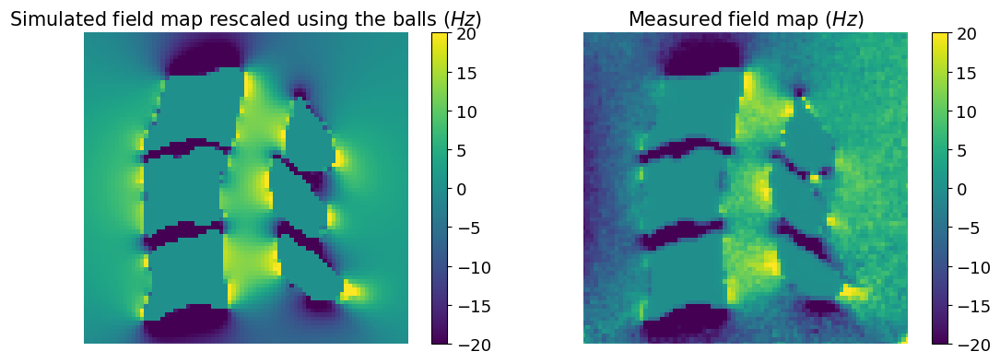

In [71]:
vmin=-20
vmax=20

fig=plt.figure(figsize=(11,4))
fig.patch.set_facecolor('white')
ymin, ymax = 0, 75
xmin, xmax = 0, 78

slice = 40

plt.subplot(1,2,1)
# plt.figure()
plt.imshow(np.transpose(fm_simu_final_corrected[:,::-1,slice]), vmin=vmin, vmax=vmax) #, aspect='auto')
plt.title('Simulated field map rescaled using the balls ($Hz$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
#plt.text(x=83, y=0, s='$\cdot 10^{-2}$', size=13)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\Simulated_rescaled_vertebrae\Simulated_rescaled_vertebrae_1.tex")

plt.subplot(1,2,2)
# plt.figure()
plt.imshow(np.transpose(fm_exp_final[:,::-1,slice]), vmin=-20, vmax=20)#, aspect='auto')
plt.title('Measured field map ($Hz$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\Simulated_rescaled_vertebrae\Simulated_rescaled_vertebrae_2.tex")


plt.tight_layout()
# plt.subplots_adjust(wspace= -0.15, top=0.9, left=-0.15)

#### letters
#plt.text(x= -107.5 ,y=3, s='a)', size=15)
#plt.text(x= 3.7 ,y=3, s='b)', size=15)

#plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\field_maps.png")
# plt.show()
    

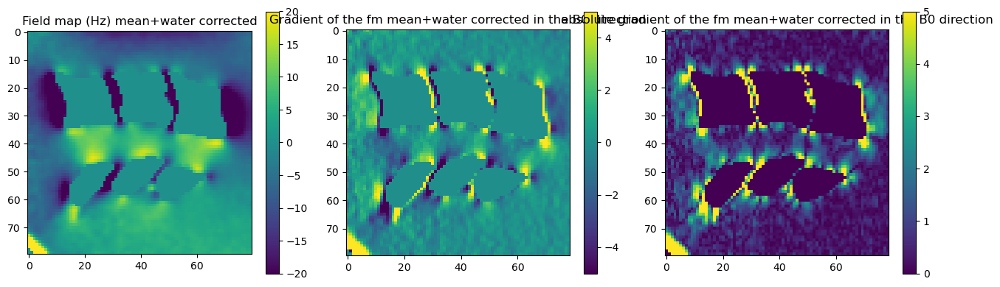

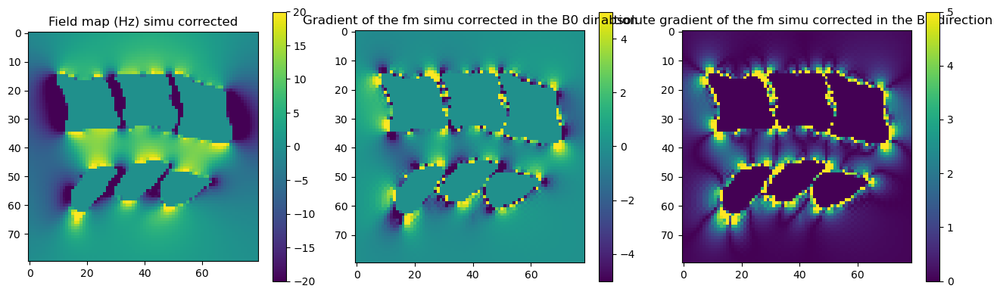

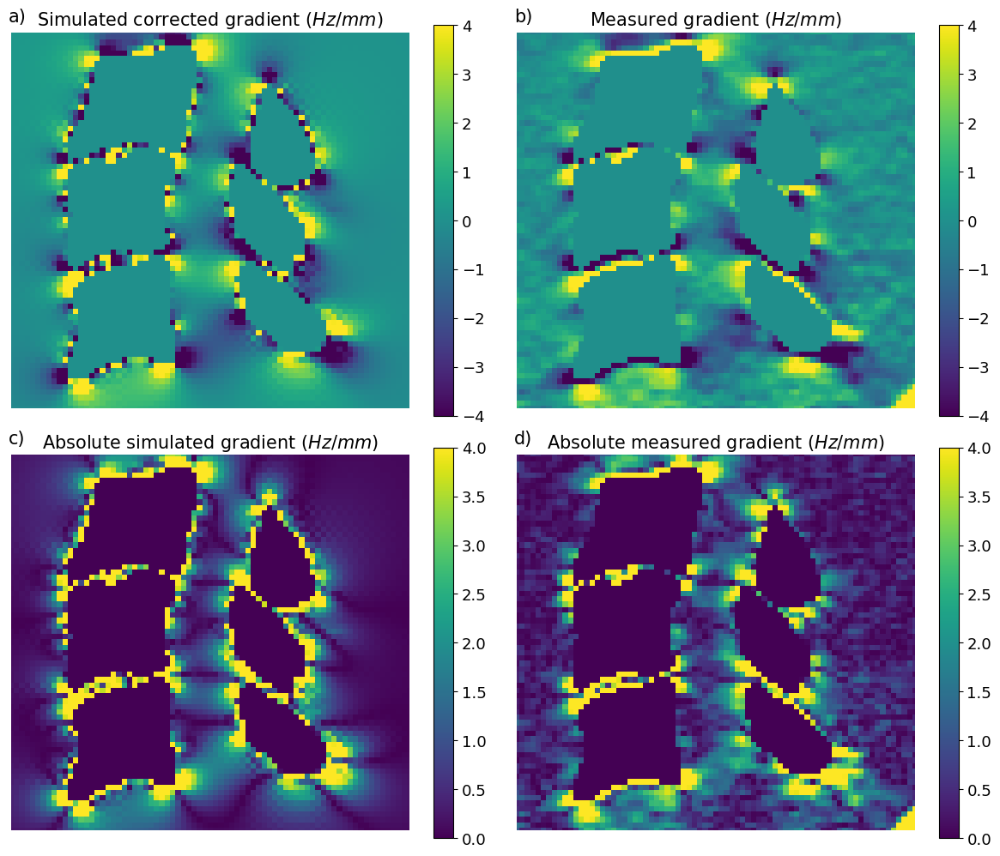

In [72]:
gradient_exp_final = gradient_fm_z_doublemask(gaussian_filter(fm_exp_final, sigma=0.75), mask_reshaped, material='mean+water corrected', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)
gradient_simu_final = gradient_fm_z_doublemask(gaussian_filter(fm_simu_final_corrected, sigma=0), mask_simu_final, material='simu corrected', plot=True, vmin=-5, vmax=5, x = x_C4, y=y, z=z, dx=dx, dy=dy, dz=dz, vmin_fm=-20, vmax_fm=20)


fig=plt.figure(figsize=(12,10))
ymin, ymax = 5, 75
xmin, xmax = 4, 78
fig.patch.set_facecolor('white')

slice = 40

plt.subplot(2,2,1)
# plt.figure()
plt.imshow(np.transpose(gradient_simu_final[:,::-1,slice]), vmin=-4, vmax=4) #, aspect='auto')
plt.title('Simulated corrected gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='a)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\gradients_rescaled\gradients_rescaled_1.tex",)


plt.subplot(2,2,2)
# plt.figure()
plt.imshow(np.transpose(gradient_exp_final[:,::-1,slice]), vmin=-4, vmax=4)#, aspect='auto')
plt.title('Measured gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='b)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\gradients_rescaled\gradients_rescaled_2.tex",)


plt.subplot(2,2,3)
# plt.figure()
plt.imshow(abs(np.transpose(gradient_simu_final[:,::-1,slice])), vmin=-0, vmax=4) #, aspect='auto')
plt.title('Absolute simulated gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='c)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\gradients_rescaled\gradients_rescaled_3.tex",)


plt.subplot(2,2,4)
# plt.figure()
plt.imshow(abs(np.transpose(gradient_exp_final[:,::-1,slice])), vmin=0, vmax=4)#, aspect='auto')
plt.title('Absolute measured gradient ($Hz/mm$)', size=15)
plt.ylim(ymax,ymin)
plt.axis('off')
plt.xlim(xmin,xmax)
cbar = plt.colorbar()
cbar.ax.tick_params(labelsize=13)
plt.text(x= 3.5 ,y=3, s='d)', size=15)
# tikzplotlib.save(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\presentations\master_thesis_PR\fig\fig_results\gradients_rescaled\gradients_rescaled_4.tex",)



plt.tight_layout()
# plt.savefig(r"C:\Users\b\OneDrive\Documents\NTNU\Master's thesis\TORONTO\abstract\images\gradients.png")

plt.show()
    

## Multiecho GRE analyse

In [73]:
path_12TE = [f"GRE_0_3MM_12TE_VERTEBRAS_SOAP15ML_0028_GRE_0.3mm_12TE_vertebras_soap15ml_20221118144958_28_e{i}.nii.gz" for i in range(1,13) ]

(600, 576, 26)


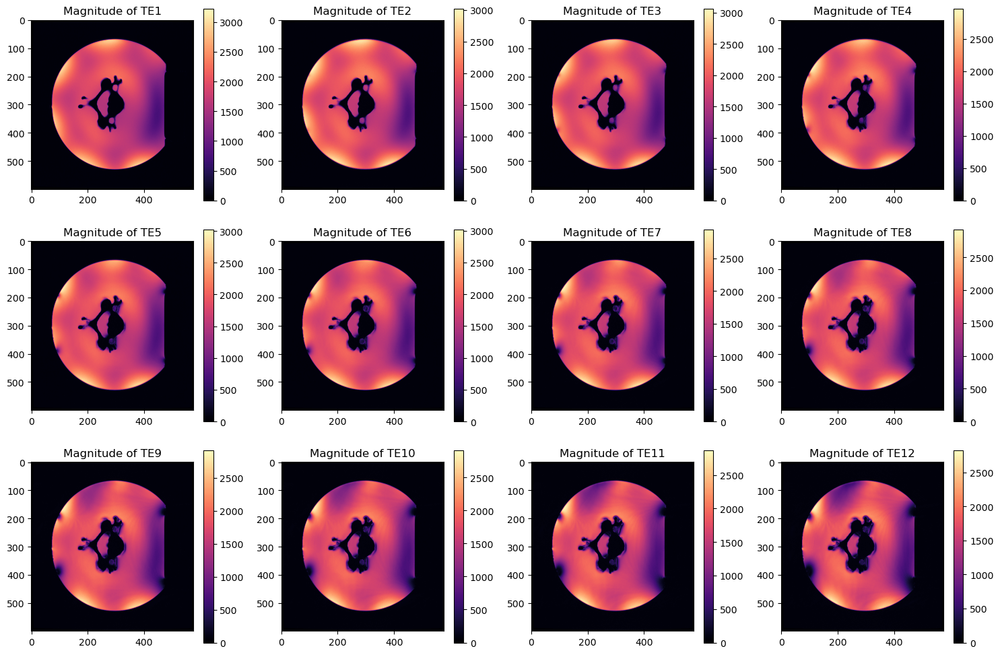

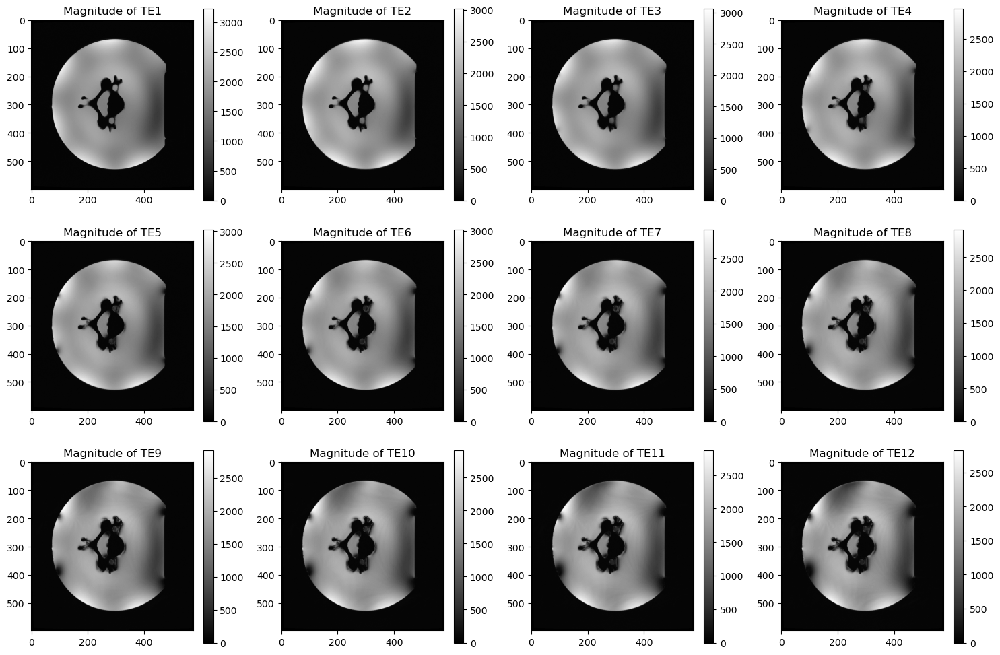

In [74]:
mag_12TE = [nib.load(path_12TE[i]).get_fdata() for i in range(12)]

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE[i][:,:,13] , cmap='magma')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

print(np.shape(mag_12TE[0]))
plt.show()

plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE[i][:,:,13] , cmap='gray')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()


Plot a sagittal view to localise the trnsversal views of interest

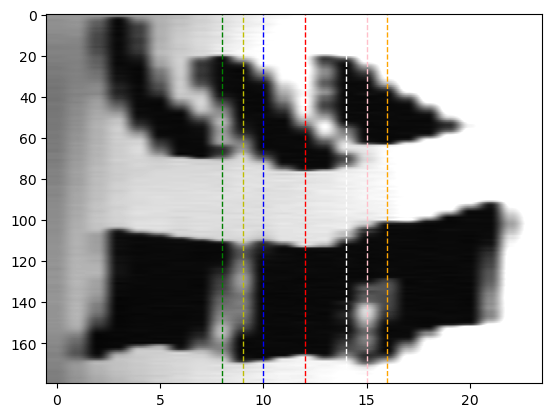

(600, 576, 26)


In [76]:
mag_rescaled = rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=90, dy=110, dz=12)
plt.imshow(mag_rescaled[100,:,:] , cmap='gray', vmin=0, vmax=1800, aspect='auto')
#plt.imshow(mag_rescaled[:,:,12] , vmin=0, vmax=1800, aspect='auto')

plt.axvline(x=12,color='r',linestyle='--', linewidth=1)
plt.axvline(x=8,color='g',linestyle='--', linewidth=1)
plt.axvline(x=9,color='y',linestyle='--', linewidth=1)
plt.axvline(x=10,color='b',linestyle='--', linewidth=1)
plt.axvline(x=14,color='w',linestyle='--', linewidth=1)
plt.axvline(x=15,color='pink',linestyle='--', linewidth=1)
plt.axvline(x=16,color='orange',linestyle='--', linewidth=1)
plt.show()
print(np.shape(mag_12TE[0]))

In [77]:
def multiTE_plot(x, mag_multiTE = mag_12TE, color='gray'):
    """
    Plot one transversal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    x : int
        x-coordinate of the slices to display
    mag_multiTE : list, optimal
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """

    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=250, y=294, z=13, dx=100, dy=110, dz=12)      
        im = ax.imshow(mag_rescaled[:,:,x], cmap=color,vmin=-30, vmax=1800)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)
    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(12, 9))
    c=0
    M1 = rescaling_FOV(mag_multiTE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)      

    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=250, y=294, z=13, dx=100, dy=110, dz=12)      
        im = ax.imshow(M1[:,:,x]-mag_rescaled[:,:,x], vmin=-600, vmax=1600)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

In [78]:
def multiTE_plot_longi(y, mag_multiTE = mag_12TE, color='gray'):
    """
    Plot one longitudinal slice for the 12 different TE and their difference from the first image.

    Parameters
    ----------
    y : int
        y-coordinate of the slices to display
    mag_multiTE : list, optional
        list of magnitude 3D arrays for each TE time. The default is mag_12TE.
    color : str, optional
        colormap to use for the images. The default is 'gray'.

    Returns
    -------
    None
        
    """

    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=250, y=294, z=13, dx=100, dy=110, dz=12)        
        im = ax.imshow(mag_rescaled[y,:,:], cmap=color, aspect='auto',vmin=-30, vmax=1800)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()
    
    fig, axes = plt.subplots(nrows=3, ncols=4, figsize=(15,9))
    c=0
    M1=rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)
    for ax in axes.flat:
        mag_rescaled = rescaling_FOV(mag_multiTE[c], x=250, y=294, z=13, dx=100, dy=110, dz=12)        
        im = ax.imshow(M1[y,:,:]-mag_rescaled[y,:,:],  aspect='auto',vmin=-600, vmax=1600)
        ax.axis('off')
        c+=1
    fig.subplots_adjust(bottom=0.1, top=0.9, left=0.1, right=0.8,
                    wspace=0.02, hspace=0.02)

    # add an axes, lower left corner in [0.83, 0.1] measured in figure coordinate with axes width 0.02 and height 0.8
    cb_ax = fig.add_axes([0.83, 0.1, 0.02, 0.8])
    cbar = fig.colorbar(im, cax=cb_ax)

    plt.show()

############# TE1 to TE12 for a slice in the top C5 (green) ################


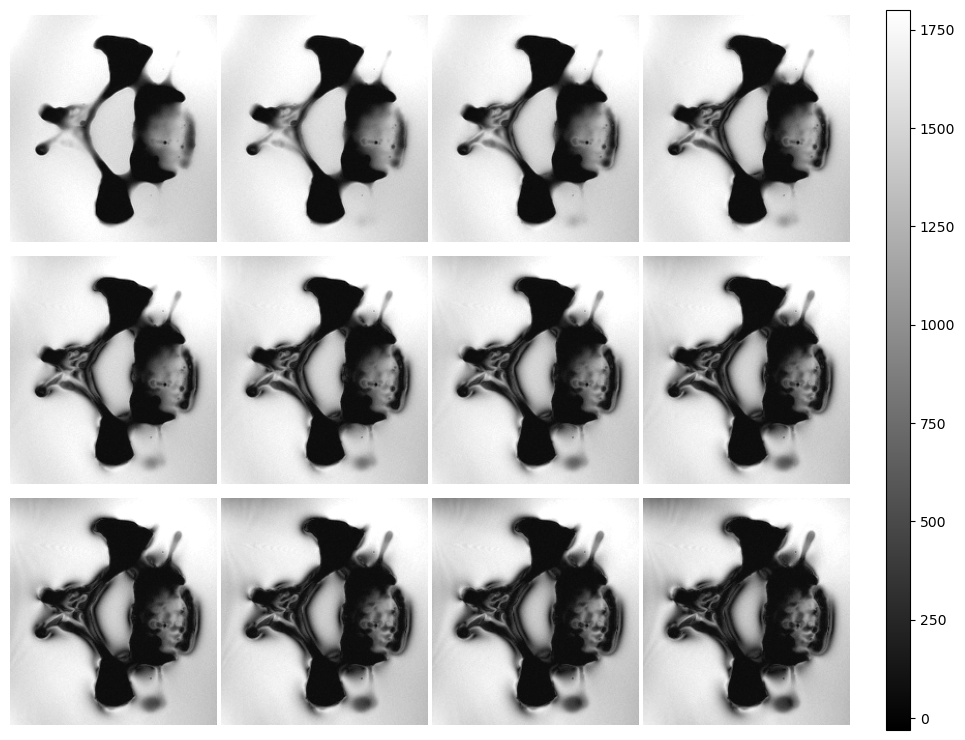

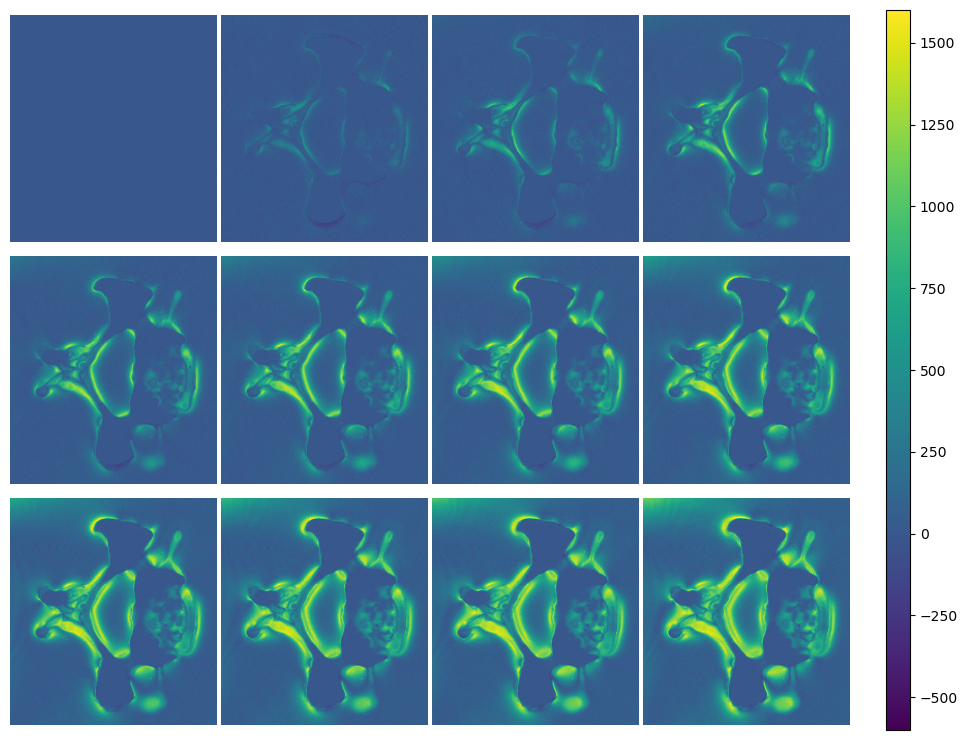

In [79]:
print('############# TE1 to TE12 for a slice in the top C5 (green) ################')
multiTE_plot(8, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################


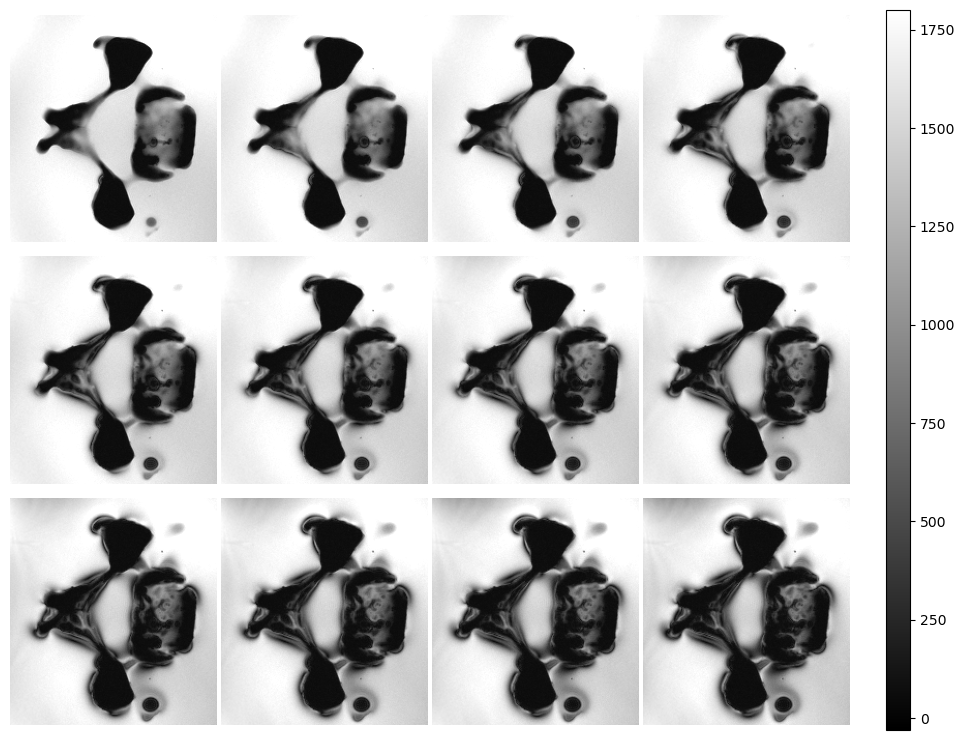

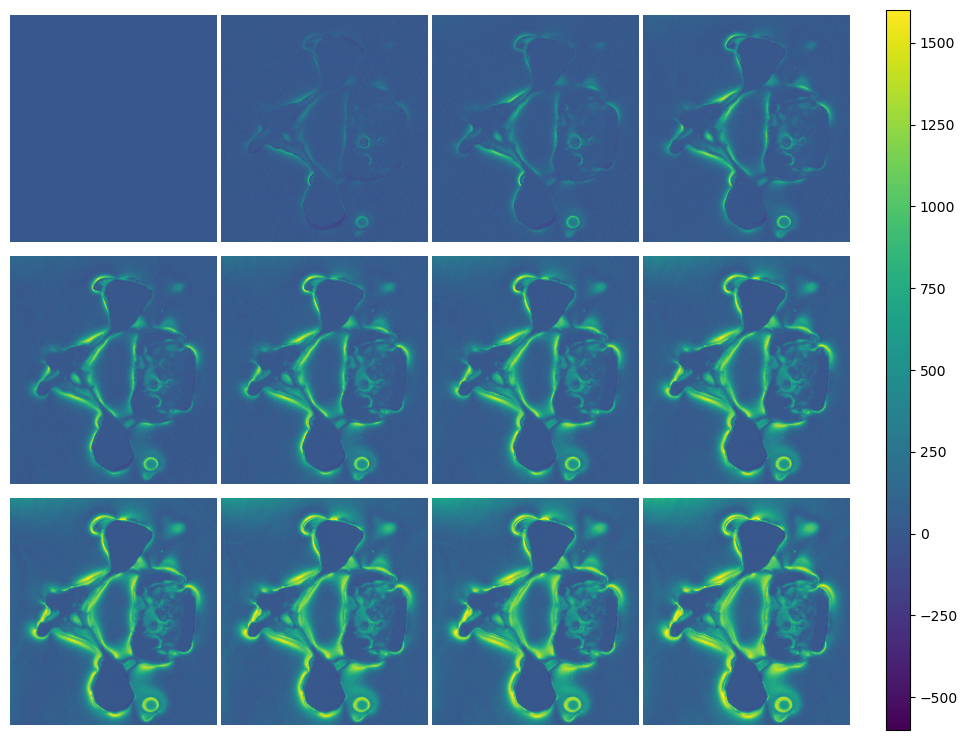

In [80]:
print('############# TE1 to TE12 for a slice between C5 and C4 (yellow) ################')
multiTE_plot(9, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################


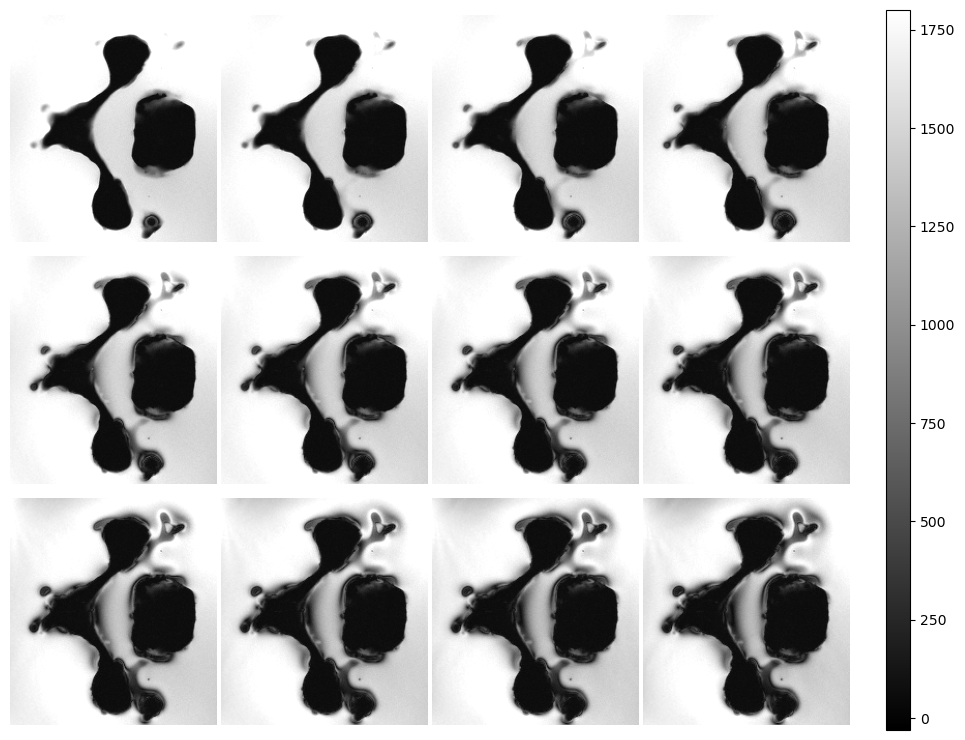

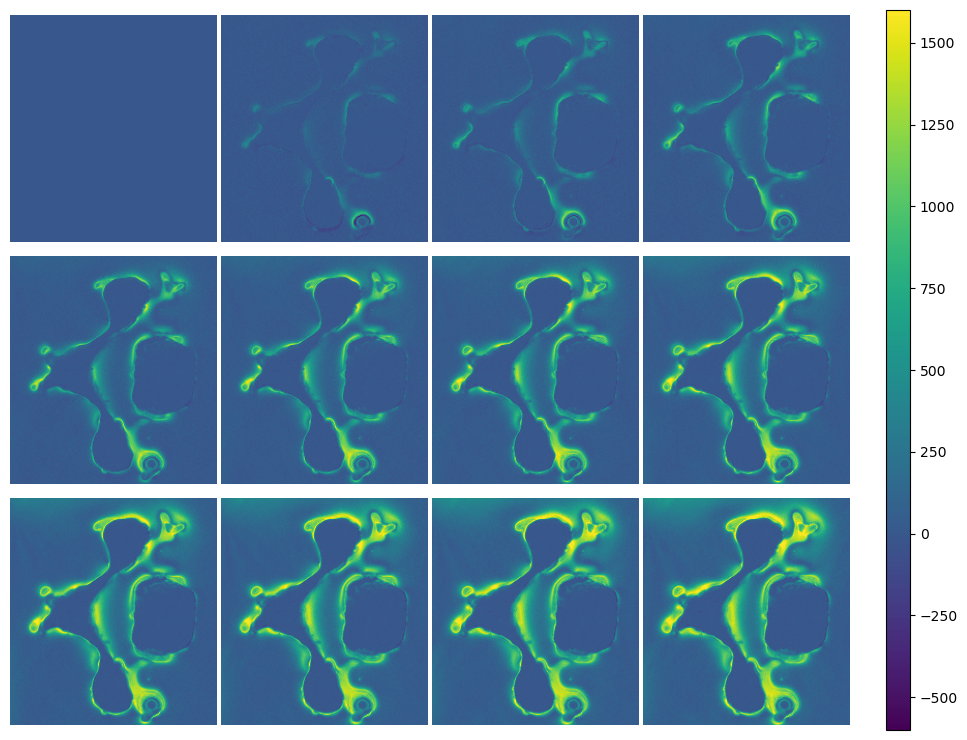

In [81]:
print('############# TE1 to TE12 for a slice in the bottom of C4 (blue) ################')
multiTE_plot(10, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the middle of C4 (red) ################


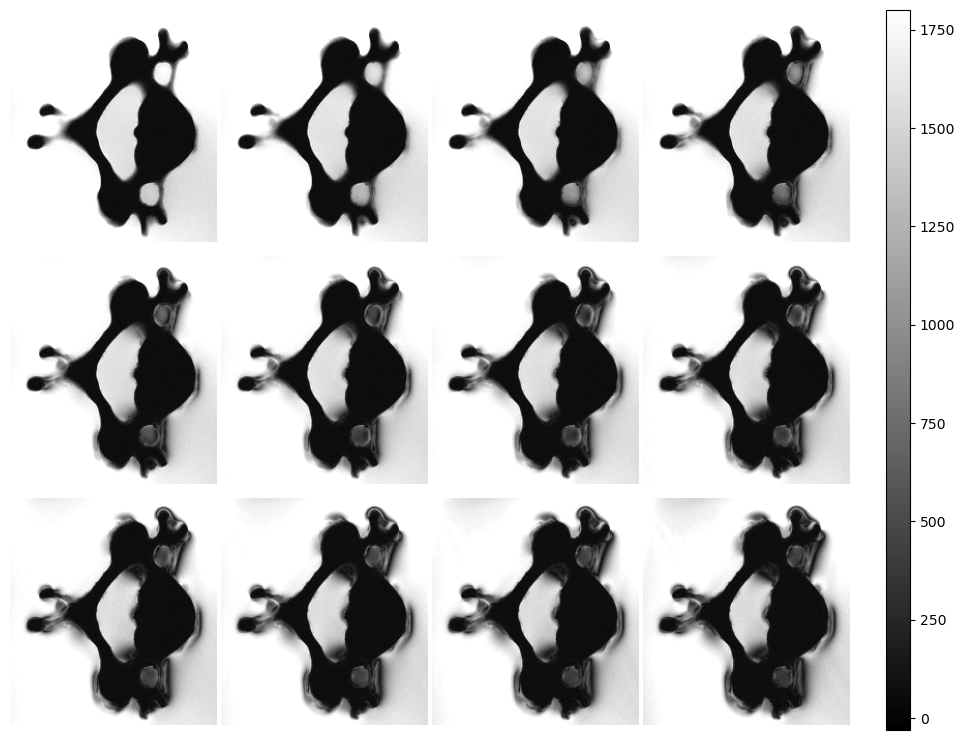

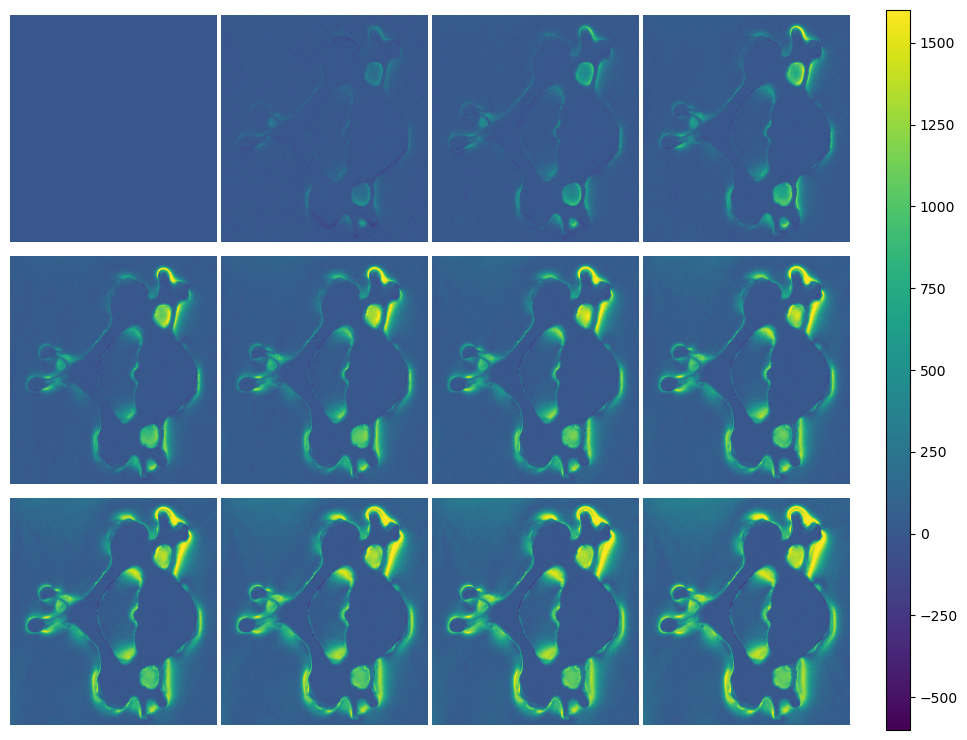

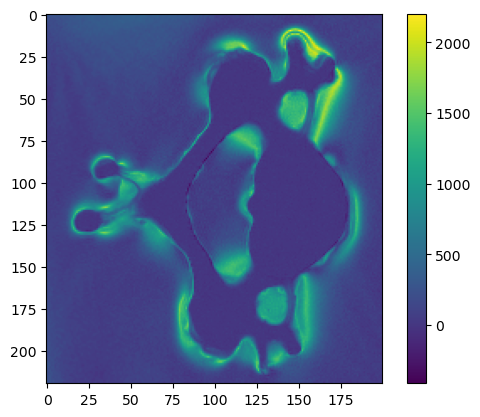

In [82]:
print('############# TE1 to TE12 for a slice in the middle of C4 (red) ################')
multiTE_plot(12, mag_multiTE = mag_12TE)

M1=rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)
M12=rescaling_FOV(mag_12TE[11], x=250, y=294, z=13, dx=100, dy=110, dz=12)

plt.imshow(M1[:,:,12]-M12[:,:,12])
plt.colorbar()

############# TE1 to TE12 for a slice in the top C4 (white) ################


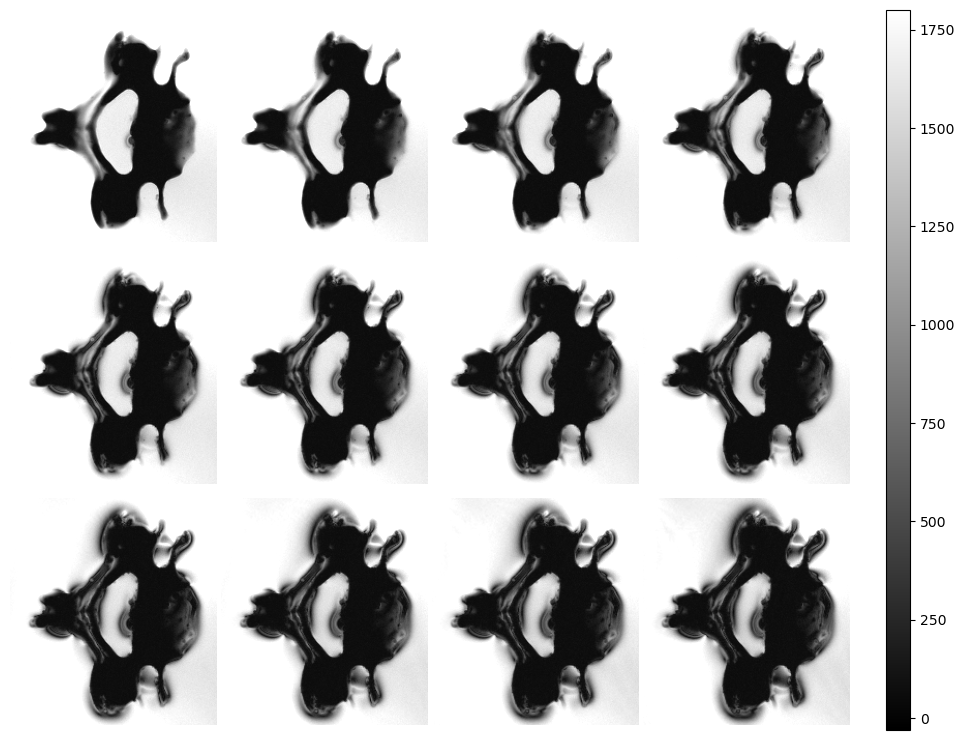

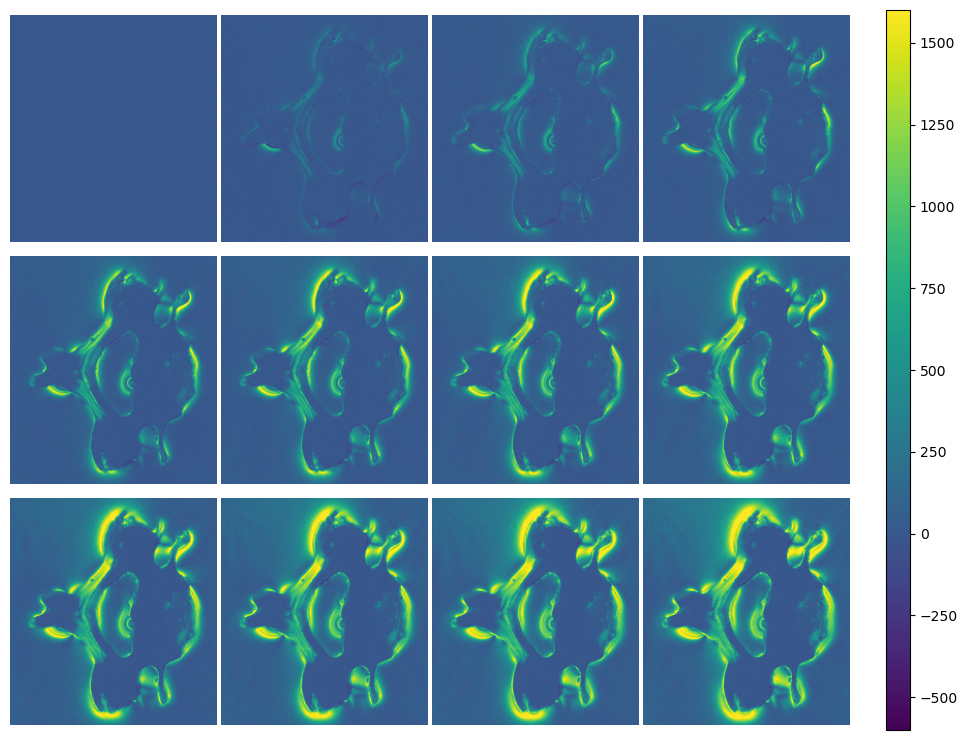

In [83]:
print('############# TE1 to TE12 for a slice in the top C4 (white) ################')
multiTE_plot(14, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice between C4 and C3 (pink) ################


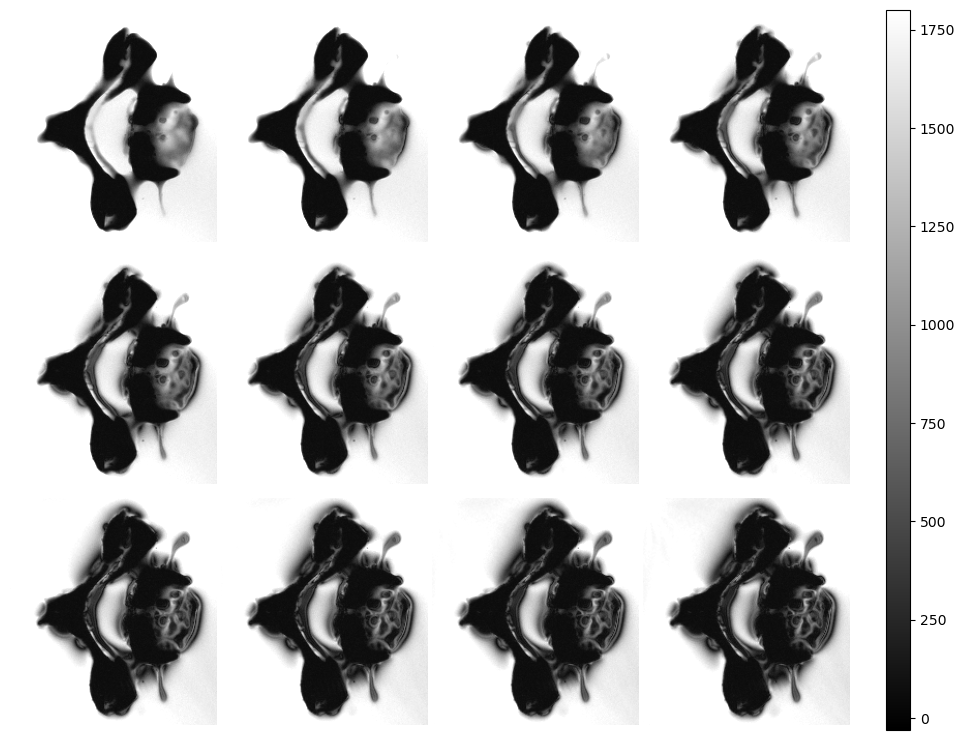

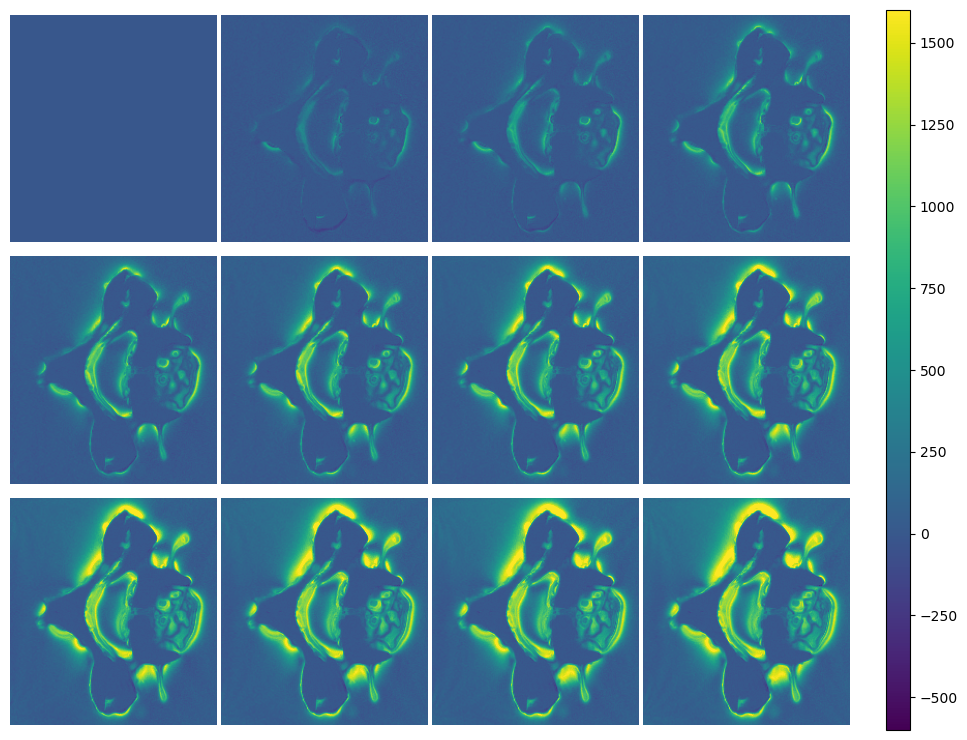

In [84]:
print('############# TE1 to TE12 for a slice between C4 and C3 (pink) ################')
multiTE_plot(15, mag_multiTE = mag_12TE)

############# TE1 to TE12 for a slice in the bottom C3 (orange) ################


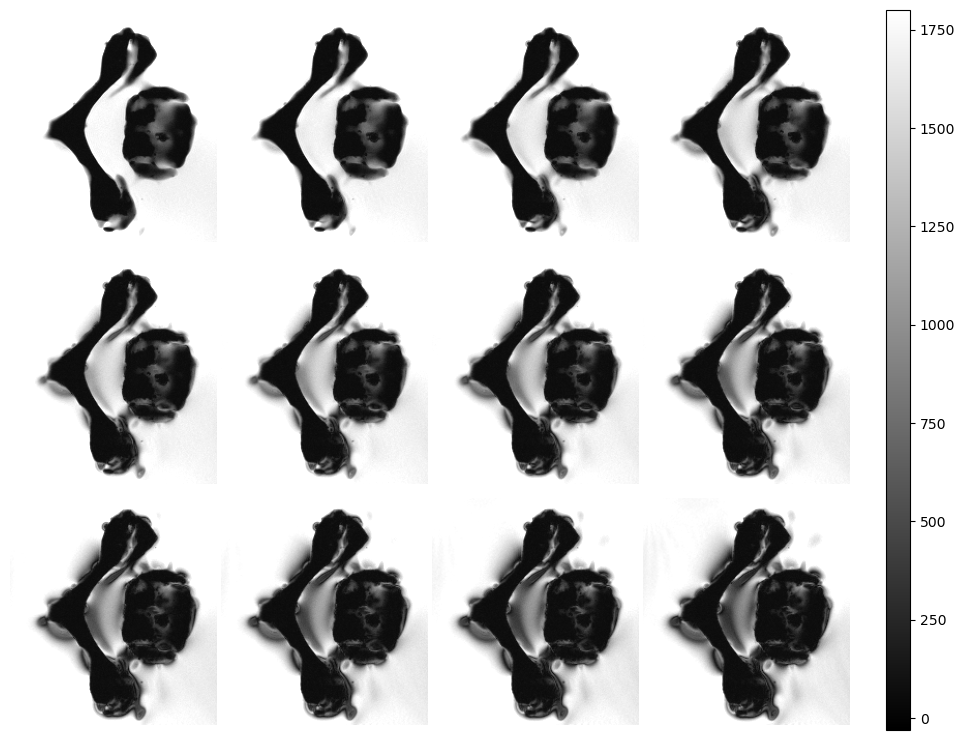

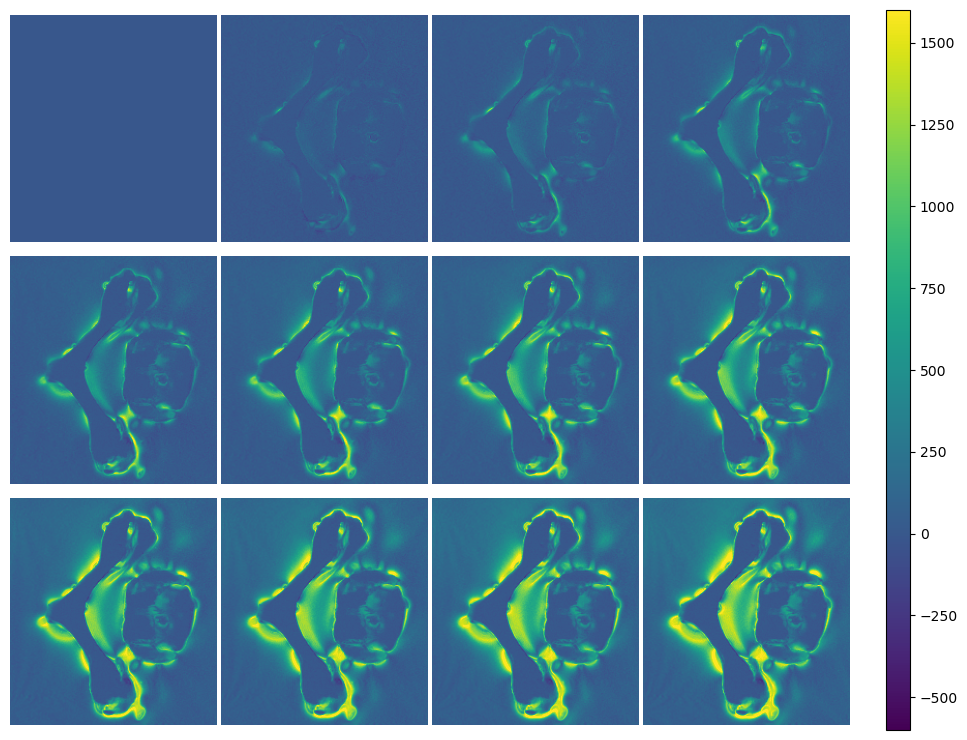

In [85]:
print('############# TE1 to TE12 for a slice in the bottom C3 (orange) ################')
multiTE_plot(16, mag_multiTE = mag_12TE)

############# TE1 to TE12 for longitudinaly ################


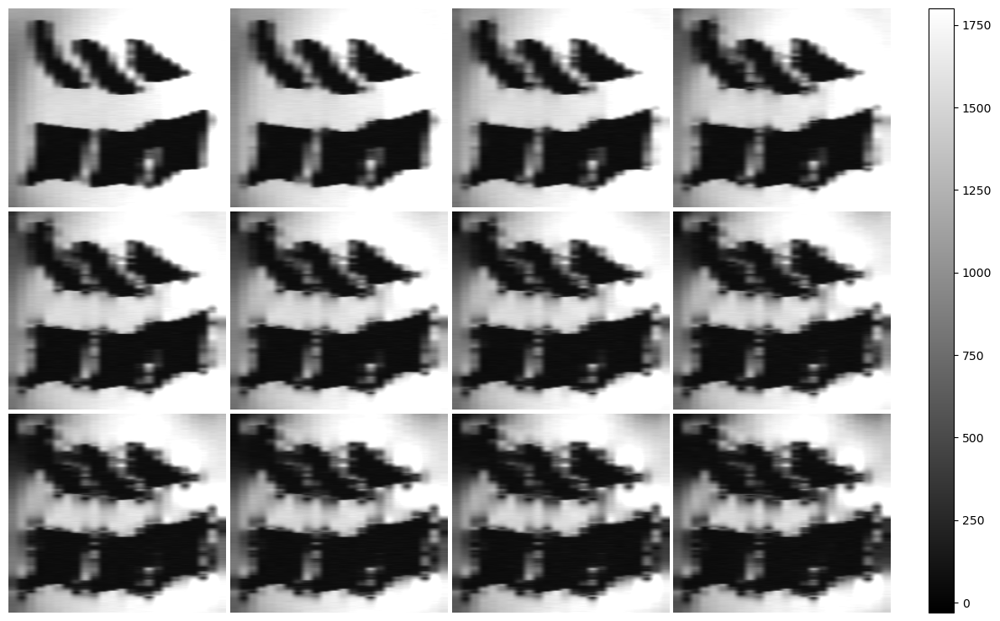

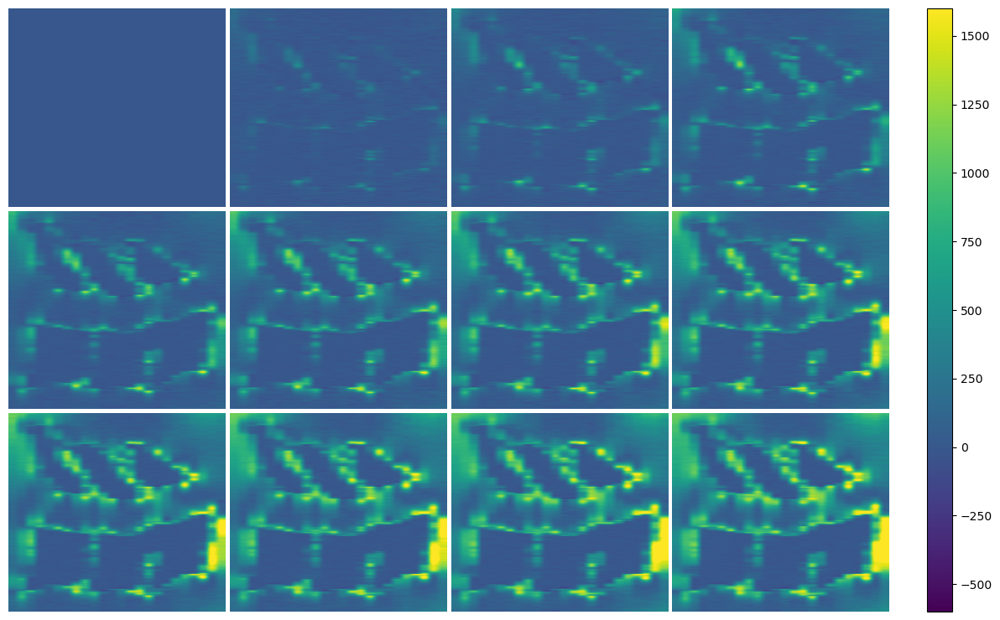

In [86]:
print('############# TE1 to TE12 for longitudinaly ################')
multiTE_plot_longi(100, mag_multiTE = mag_12TE)

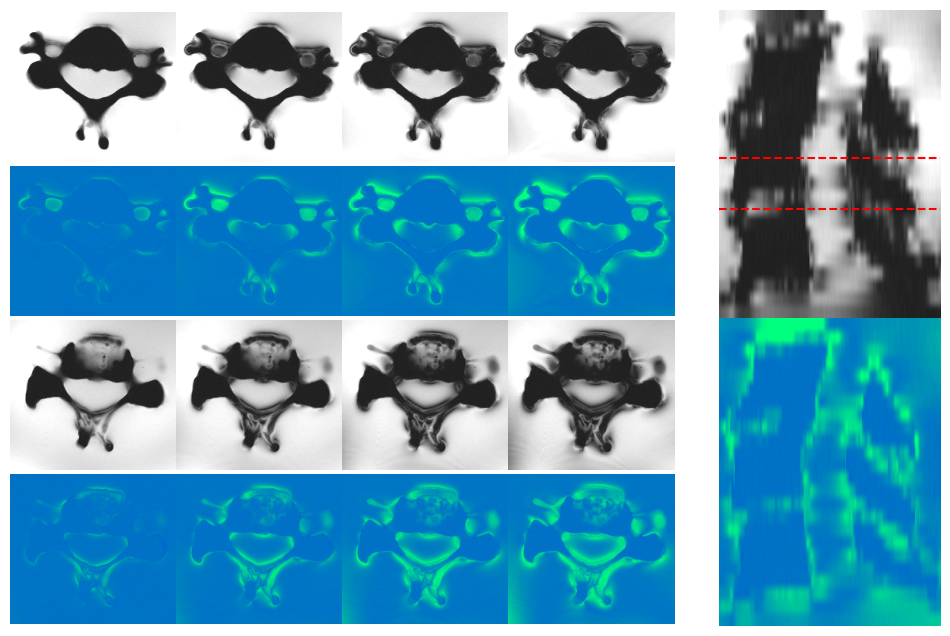

In [87]:
fig = plt.figure(figsize=(12,8))
fig.patch.set_facecolor('white')

gs0 = GridSpec(1, 2, figure=fig, width_ratios=[0.75,0.25],wspace=0.1)

gs00 = gridspec.GridSpecFromSubplotSpec(4, 4, subplot_spec=gs0[0], wspace=0, hspace=0) #left

def plot_2lines(z, ligne):
    for i in range(4): # first line --> echos 3-6-9-12 
        ax = fig.add_subplot(gs00[ligne-1, i])
        mag = rescaling_FOV(mag_12TE[2+3*i], x=250, y=294, z=13, dx=100, dy=110, dz=12)
        ax.imshow(np.transpose(mag[:,::-1,z], (1,0)), cmap='gray',vmin=-200, vmax=1800)
        ax.axis('off')

    M1 = rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12) #second line --> differnece with first echo line
    for i in range(4):
        ax = fig.add_subplot(gs00[ligne, i])
        mag = rescaling_FOV(mag_12TE[2+3*i], x=250, y=294, z=13, dx=100, dy=110, dz=12)
        diff = M1-mag
        ax.imshow(np.transpose(diff[:,::-1,z], (1,0)),vmin=-1300, vmax=1600, cmap='winter')
        ax.axis('off')
        
plot_2lines(12, 1) #plot red 
plot_2lines(8,3) #plot green

    
#################################################################################################
gs01 = gs0[1].subgridspec(2, 1,wspace=0, hspace=0) # right
y=100

ax = fig.add_subplot(gs01[0])
mag = rescaling_FOV(mag_12TE[11], x=250, y=294, z=13, dx=100, dy=110, dz=12) 
magsplit = mag[:,::-1,::-1]
ax.imshow(np.transpose(magsplit[y,10:-10,:]), cmap='gray', aspect='auto',vmin=-200, vmax=1800)

ax.axis('off')
# ax.axhline(y=12,color='r',linestyle='--', linewidth=1.5)
# ax.axhline(y=8,color='r',linestyle='--', linewidth=1.5)

ax.axhline(y=23-12,color='r',linestyle='--', linewidth=1.5)
ax.axhline(y=23-8,color='r',linestyle='--', linewidth=1.5)

M1=rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)
diff = M1-mag

ax = fig.add_subplot(gs01[1])
mag = rescaling_FOV(mag_12TE[11], x=250, y=294, z=13, dx=100, dy=110, dz=12) 
diffsplit = diff[:,::-1,::-1]
ax.imshow(np.transpose(diffsplit[y,10:-10,:]), aspect='auto',vmin=-1300, vmax=1600, cmap='winter')
ax.axis('off')


#### letter
# plt.text(x= -575 ,y=-22.5, s='b)', size=15)
# plt.text(x= -0 ,y=-22.5, s='e)', size=15)
# plt.text(x= -575 ,y=1, s='d)', size=15)
# plt.text(x= -565 ,y=-25.5, s='TE=20.28ms', size=15)
# plt.text(x= -425 ,y=-25.5, s='TE=40.40ms', size=15)
# plt.text(x= -295 ,y=-25.5, s='TE=60.20ms', size=15)
# plt.text(x= -155 ,y=-25.5, s='TE=80.0ms', size=15)
# plt.text(x= 40 ,y=-25.5, s='TE=80.0ms', size=15)
# plt.text(x= -680 ,y=-25.5, s='TE=26.26ms', size=16)

# plt.savefig(r"figures/ME-GRE_test4_first_vertebral_phantom_corrected.png", dpi=200)


# plt.tight_layout()
# plt.suptitle("Multiecho")

# tikzplotlib.save(r"masterization4_toto_test.tex")
plt.show()

## Comparison signal loss by multiecho - z-gradient

We want to compare the loss obtained with the two differnet acquisitions

In [88]:
print("Header fm:")

header_fm = nib.load(path_mag1_vertebrae).header
print(header_fm)



print("#################################################################################################")
print("Header multiecho:")

header_12TE = [nib.load(path_12TE[i]).header for i in range(12)]
print(header_12TE[0])


Header fm:
<class 'nibabel.nifti1.Nifti1Header'> object, endian='<'
sizeof_hdr      : 348
data_type       : b''
db_name         : b''
extents         : 0
session_error   : 0
regular         : b'r'
dim_info        : 54
dim             : [  3 180 180 160   1   1   1   1]
intent_p1       : 0.0
intent_p2       : 0.0
intent_p3       : 0.0
intent_code     : none
datatype        : int16
bitpix          : 16
slice_start     : 0
pixdim          : [1.   1.   1.   1.   1.05 0.   0.   0.  ]
vox_offset      : 0.0
scl_slope       : nan
scl_inter       : nan
slice_end       : 0
slice_code      : unknown
xyzt_units      : 10
cal_max         : 0.0
cal_min         : 0.0
slice_duration  : 0.0
toffset         : 0.0
glmax           : 0
glmin           : 0
descrip         : b'TE=3.1;Time=180410.228;phase=1;mb=3'
aux_file        : b''
qform_code      : scanner
sform_code      : scanner
quatern_b       : 0.5
quatern_c       : -0.5
quatern_d       : -0.5
qoffset_x       : 79.5
qoffset_y       : 90.0
qoffset_z 

Compute the signal loss from the FM

In [89]:
m,n,p = np.shape(fm_exp_final)
signal_loss_fm1= np.zeros((m,n,p))

for i in tqdm.tqdm(range(m)):
    for j in range(1,n-1):
        for k in range(p):
            Y=np.array([fm_exp_final[i,j-1,k],fm_exp_final[i,j,k],fm_exp_final[i,j+1,k]])
            X=np.array([1,2,3]) #because there is a difference of 1mm between each voxel
            lin = scipy.stats.linregress(X, Y) # a linear regression to get the slope 
            slope =lin.slope
            signal_loss_fm1[i,j,k]=slope
    

100%|██████████████████████████████████████████████████████████████████████████████████| 80/80 [01:24<00:00,  1.06s/it]


#### Lets try to find the exact positions:
Using the header we have:
$z_{ME} = 3*k_{ME}-48.34$ and $z_{fm} = 1*j_{fm}-89$.

So after pivoting the fm to get exactly the same orientation and reshaping like we did before, we got that the first ME slice has a z-position of -45.34, while the first of the rotated fm has a z-position of -51.

Finally we can see that, in our final matrixes: $slice_{fm} = 3*slice_{ME}+5.66$ 

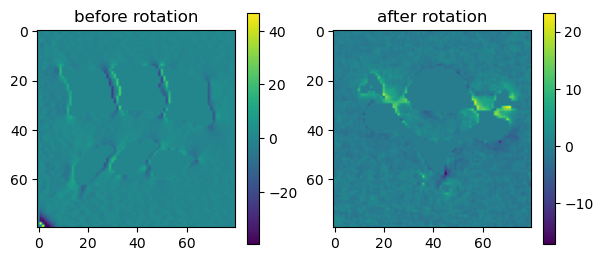

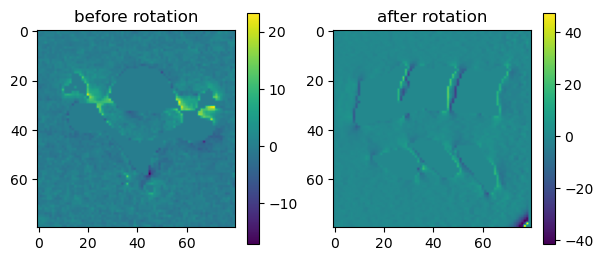

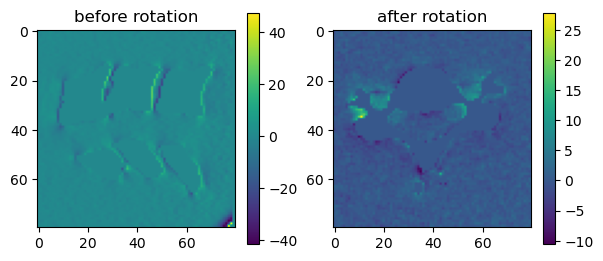

In [90]:
signal_loss_fm1_rotated = rotation90clock(rotation90clock(rotation90clock(signal_loss_fm1*mask_reshaped)))


In [93]:
def signal_loss_comp(sliceME, sigma=0.5):
    """
    Plot the comparison of the two signal losses for the same aligned slice

    Parameters
    ----------
    sliceME : int
        coordinate of the trasnversal slice we want to display
    sigma : float, optional
        Standard deviation of the Gaussian smoothing of the FM's signal loss

    Returns
    -------
    None
        
    """
    
    
    #signal loss from the multiecho acquisition
    M1 = rescaling_FOV(mag_12TE[0], x=250, y=294, z=13, dx=100, dy=110, dz=12)      
    M12 = rescaling_FOV(mag_12TE[11], x=250, y=294, z=13, dx=100, dy=110, dz=12) 
    signal_loss_multi = (M1-M12)[::-1,::-1,:]
    signal_loss_fm_rotated = abs(gaussian_filter(signal_loss_fm1_rotated, sigma=sigma))
    print(np.shape(signal_loss_multi))
    print(np.shape(signal_loss_fm_rotated))


    #signal loss comparison
    slice_fm = sliceME*3+6

#     plt.figure(figsize=(10,4))
#     plt.subplot(121)
#     plt.figure()
#     plt.imshow(signal_loss_fm_rotated[10:70,40,76:6:-1].T, vmin=-0, vmax=6)
#     plt.axhline(y=slice_fm, c="r")
    plt.figure()
    plt.imshow(signal_loss_fm_rotated[11:68,40,6:76], vmin=-0, vmax=6)
    plt.axvline(x=slice_fm-6, c="r")
    plt.axis('off')
    plt.tight_layout()
#     plt.savefig(f"figures/signal_loss_sagit_slice{sliceME}.png")
#     tikzplotlib.save(f"figures/Slices_FM_MEGRE/signal_loss_sagit_slice{sliceME}.tex")
#     plt.subplot(122)
#     plt.imshow(signal_loss_multi[108,:,:],vmin=-30, vmax=1800, aspect="auto")
#     plt.axvline(x=sliceME, c="r")
    

#     plt.figure(figsize=(13,7))
#     plt.subplot(121)
    plt.figure()
#     plt.title("Signal loss from the field map acquisition")
    plt.imshow((signal_loss_fm_rotated[8:69,4:71,slice_fm]), vmin=-0, vmax=6)
    plt.axis('off')
    plt.tight_layout()
#     plt.savefig(f"figures/signal_loss_FM_slice{sliceME}.png")
#     tikzplotlib.save(f"figures/Slices_FM_MEGRE/signal_loss_FM_slice{sliceME}.png")
#     plt.subplot(122)
    plt.figure()
#     plt.title("Signal loss from the Multiecho acquisition")
    plt.imshow(np.transpose(signal_loss_multi[:,:,sliceME]),vmin=-30, vmax=1800)
    plt.axis('off')
    plt.tight_layout()
#     plt.savefig(f"figures/signal_loss_MEGRE_slice{sliceME}.png")
#     tikzplotlib.save(f"figures/Slices_FM_MEGRE/signal_loss_MEGRE_slice{sliceME}.png")


(220, 200, 24)
(80, 80, 80)


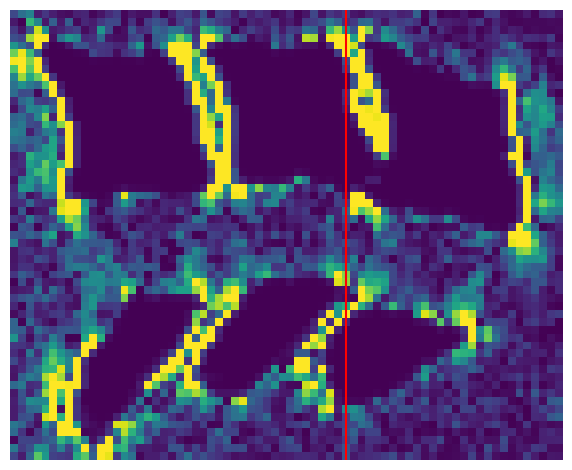

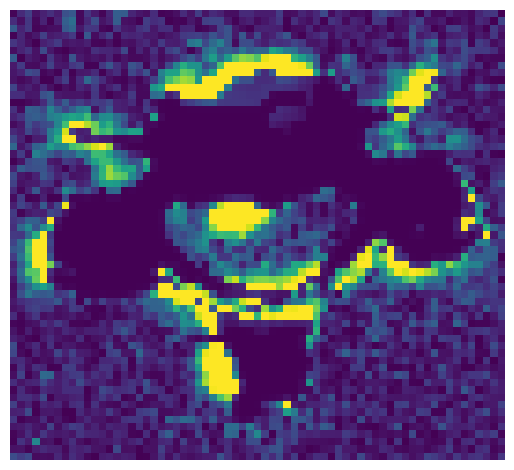

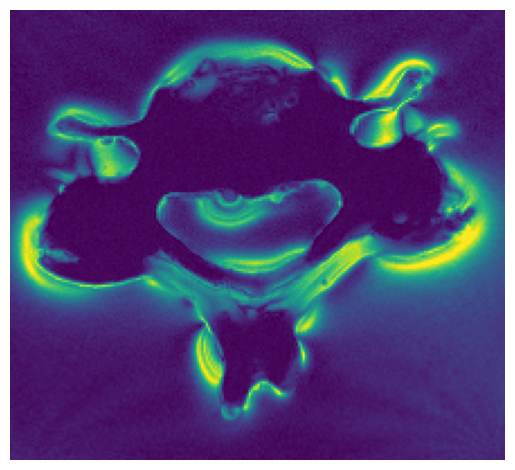

In [94]:
signal_loss_comp(sliceME=14, sigma=0.4)

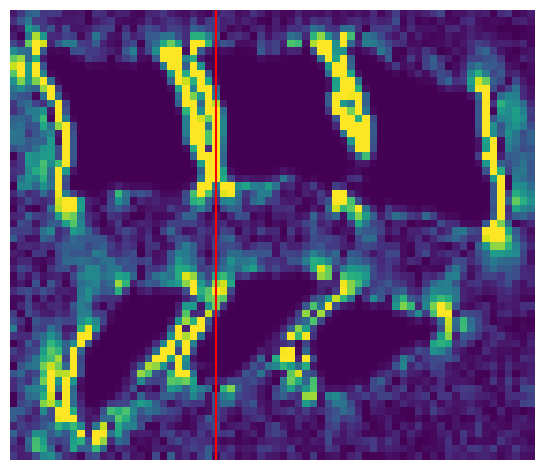

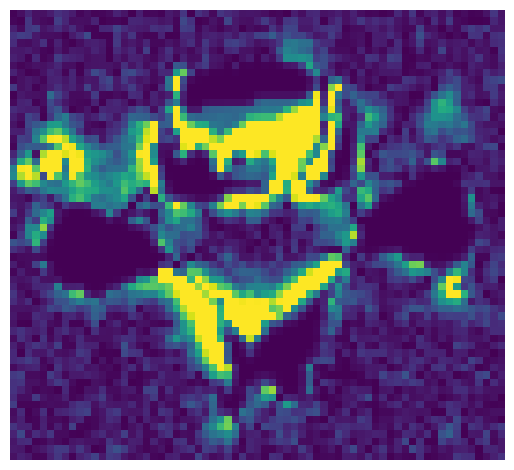

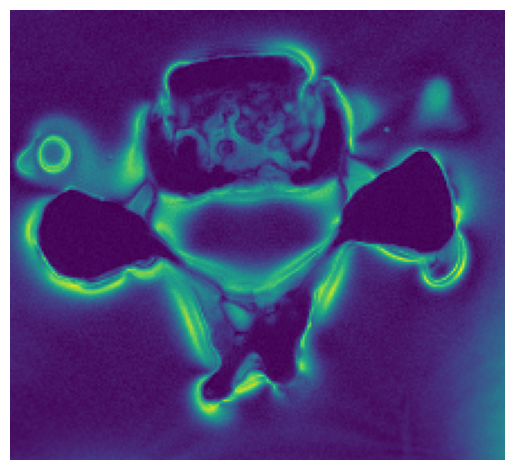

In [136]:
signal_loss_comp(sliceME=9, sigma=0.5)

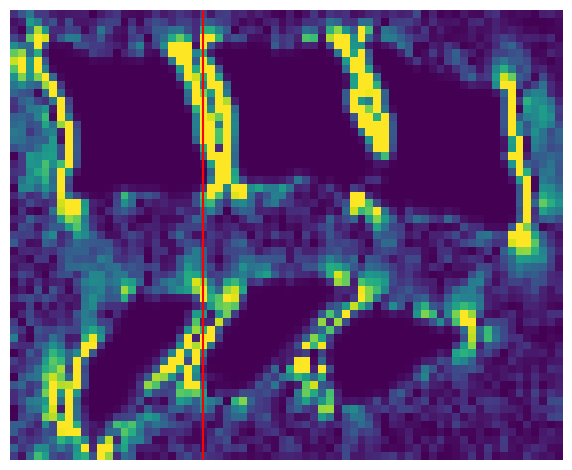

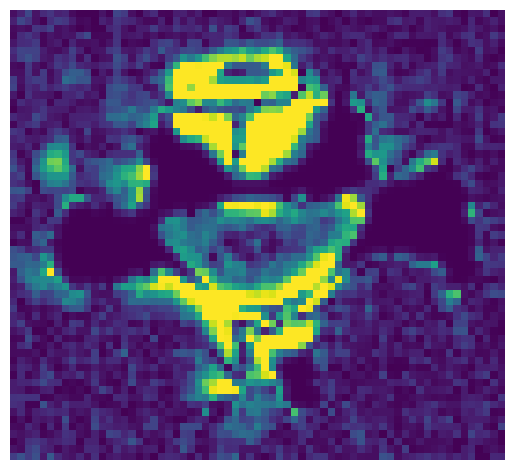

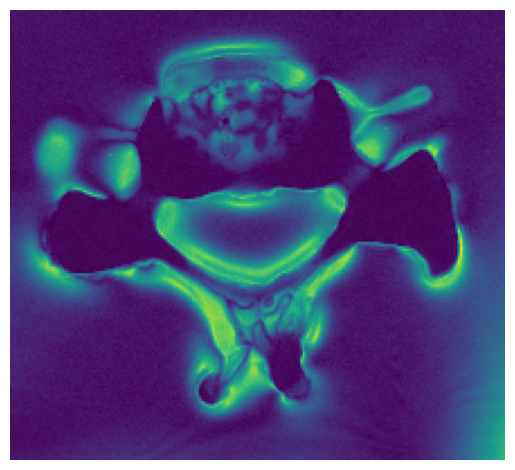

In [154]:
signal_loss_comp(sliceME=8, sigma=0.5)

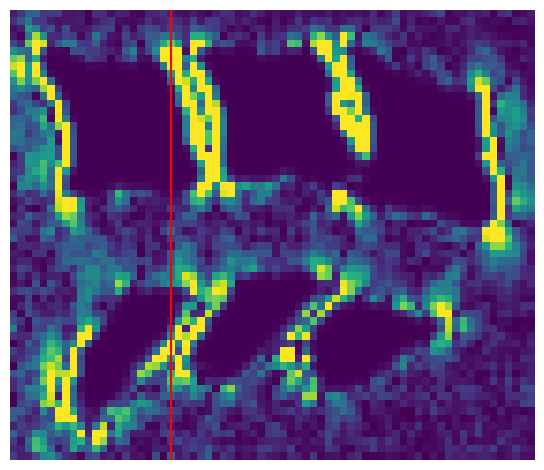

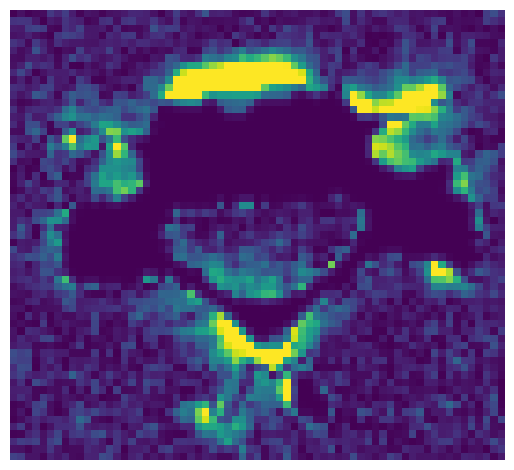

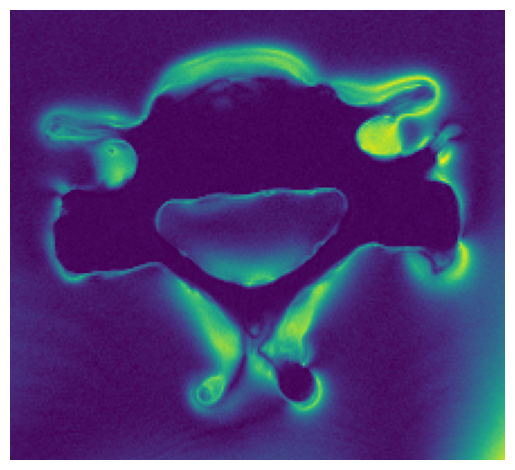

In [138]:
signal_loss_comp(sliceME=7, sigma=0.5)

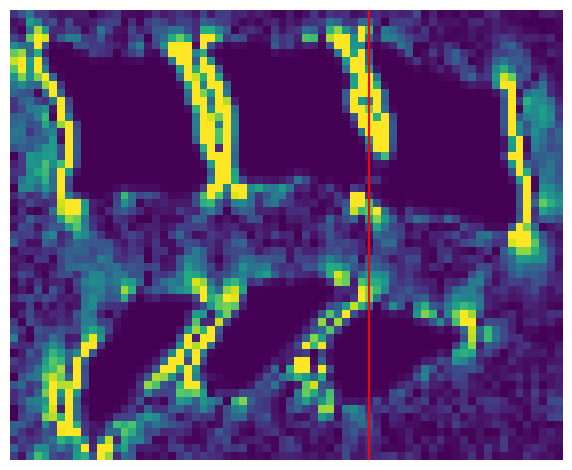

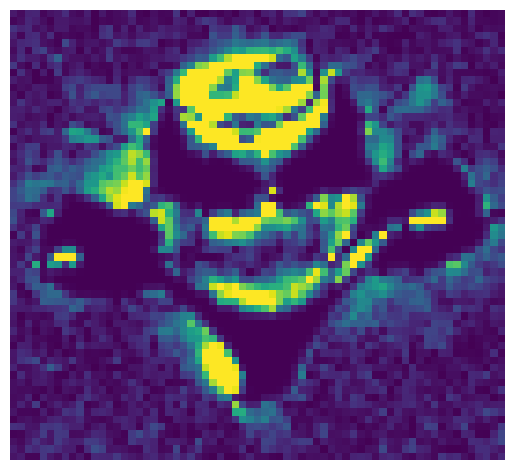

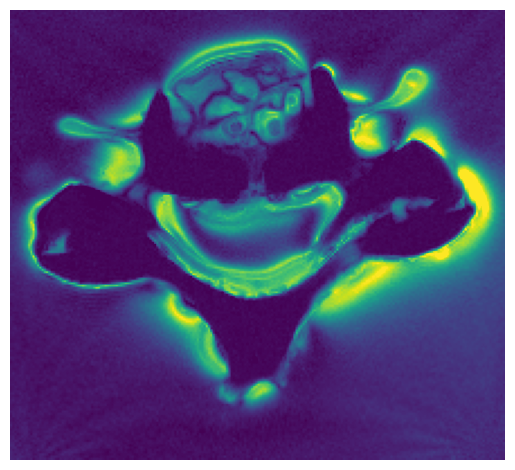

In [155]:
signal_loss_comp(sliceME=15, sigma=0.5)

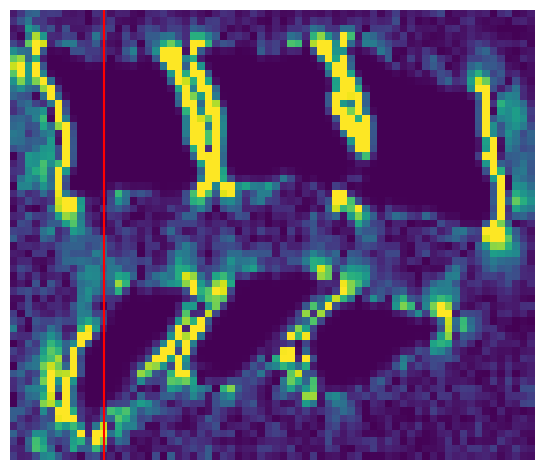

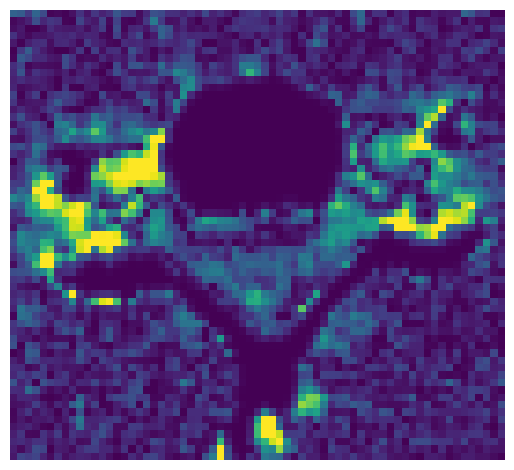

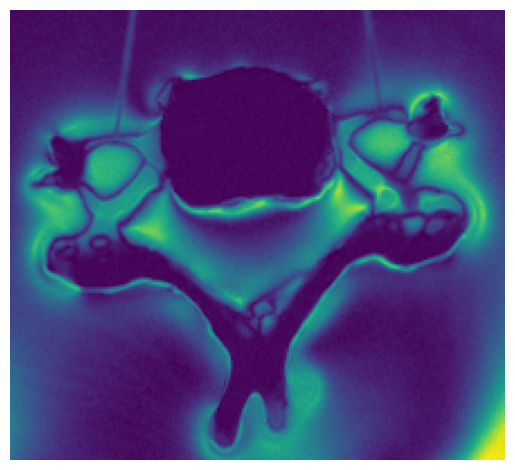

In [140]:
signal_loss_comp(sliceME=4, sigma=0.5)

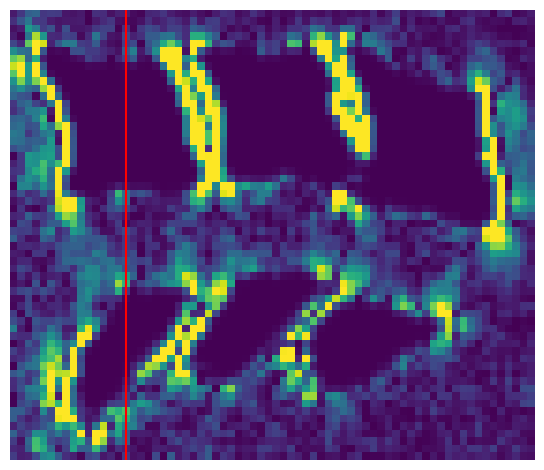

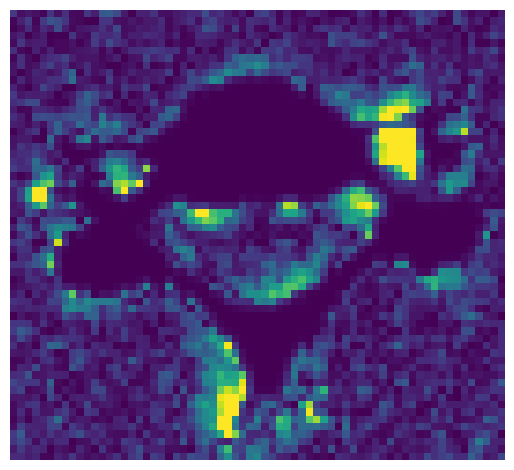

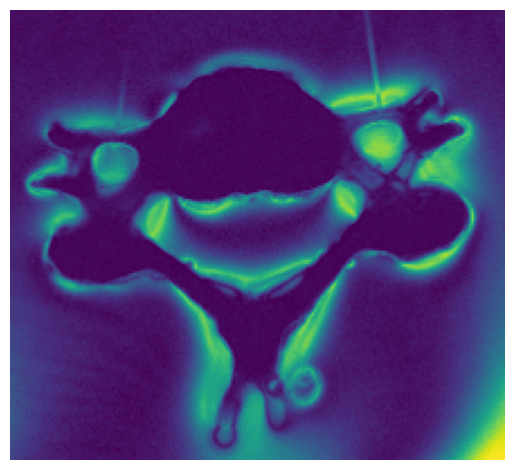

In [141]:
signal_loss_comp(sliceME=5, sigma=0.5)

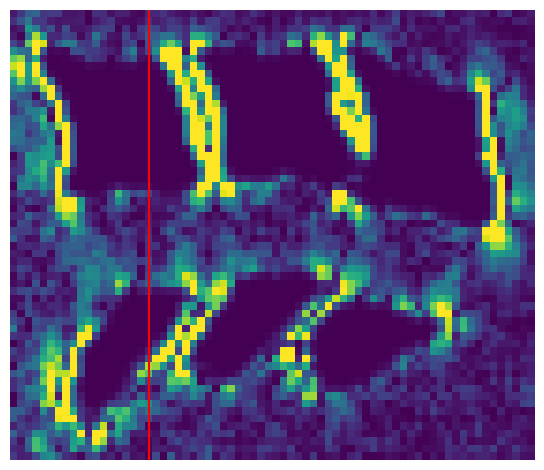

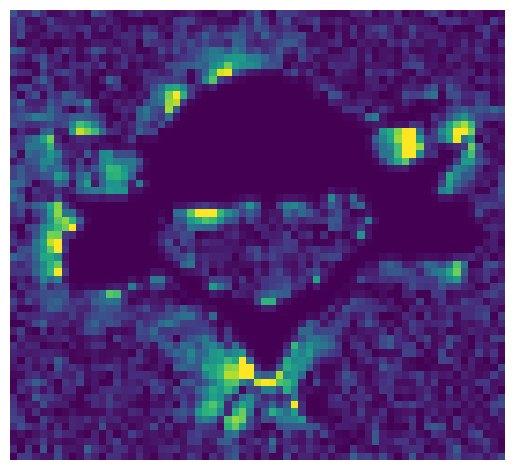

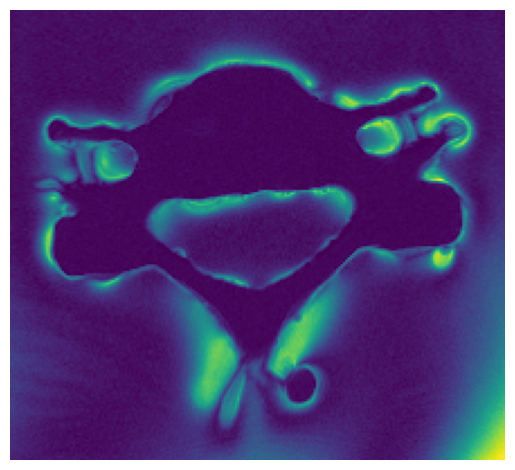

In [143]:
signal_loss_comp(sliceME=6, sigma=0.5)

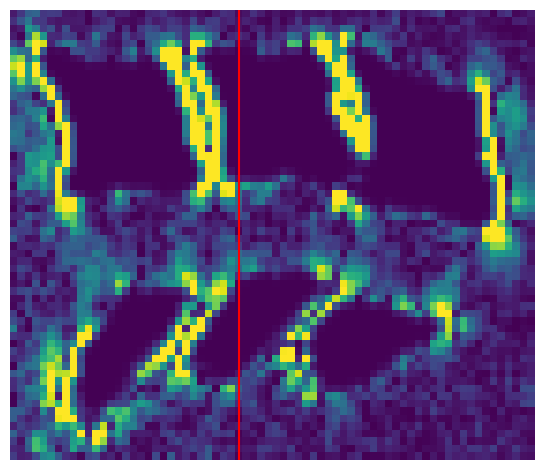

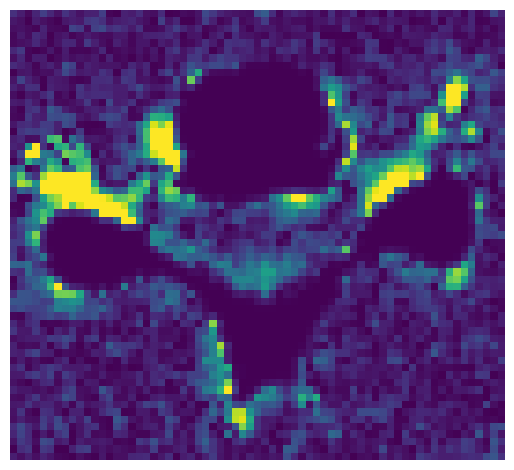

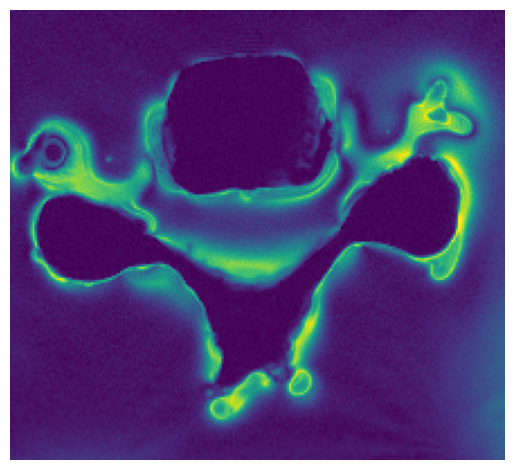

In [144]:
signal_loss_comp(sliceME=10, sigma=0.5)

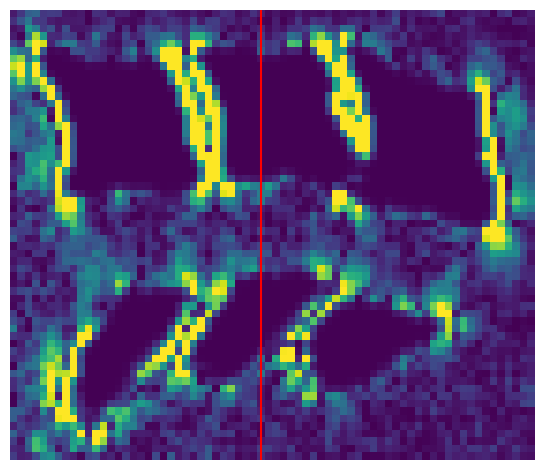

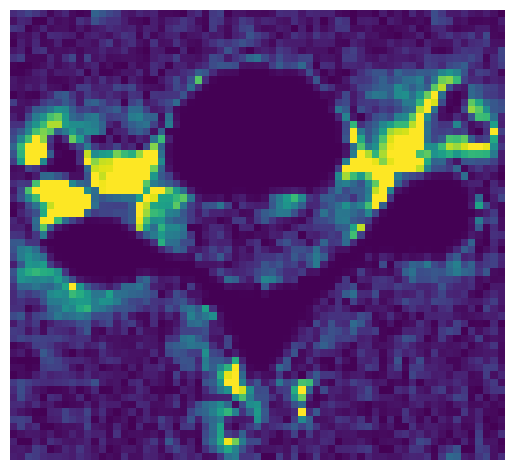

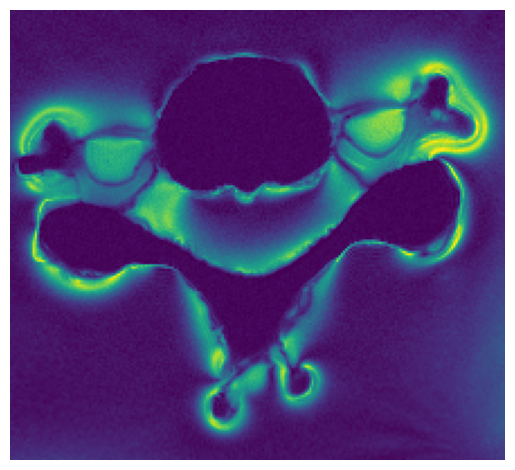

In [145]:
signal_loss_comp(sliceME=11, sigma=0.5)

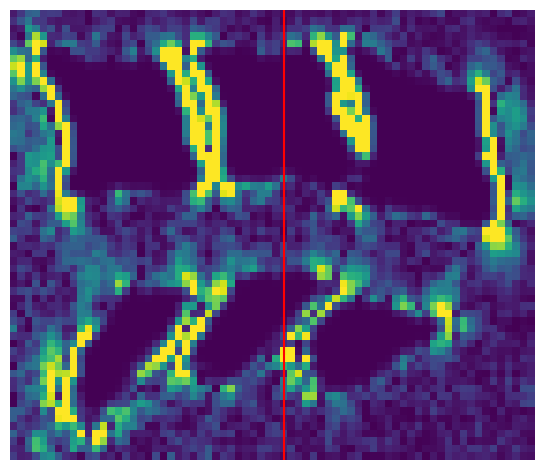

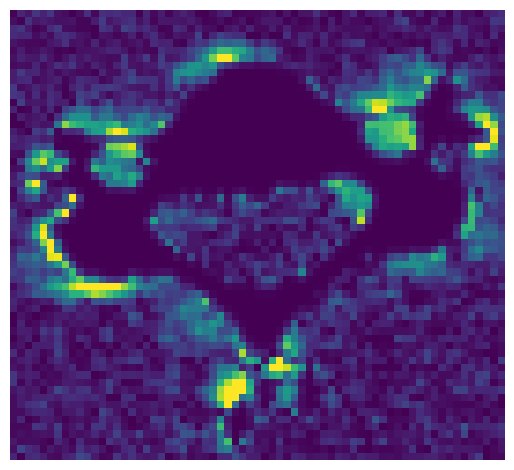

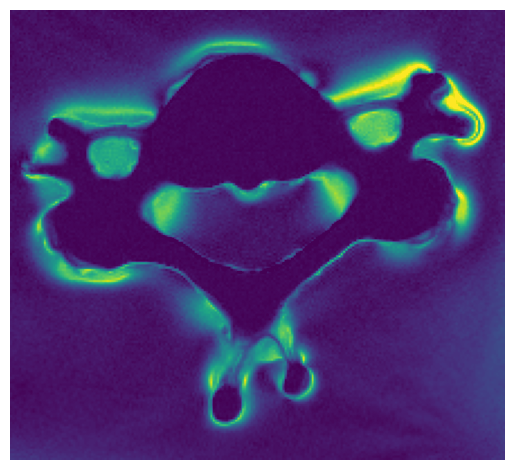

In [146]:
signal_loss_comp(sliceME=12, sigma=0.5)

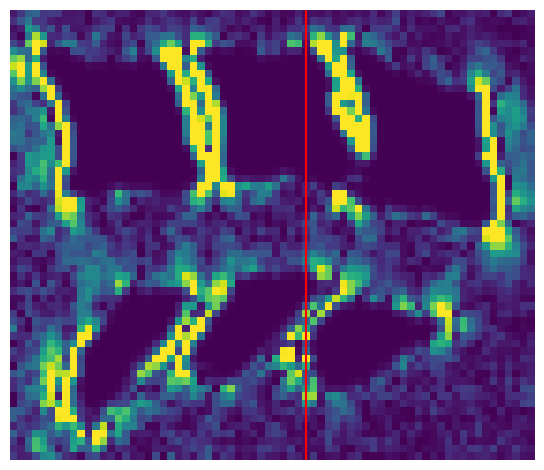

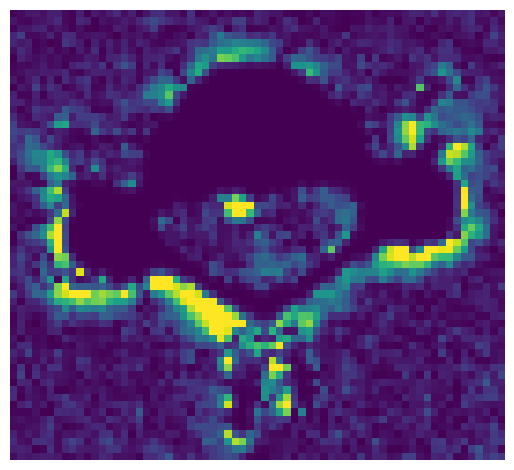

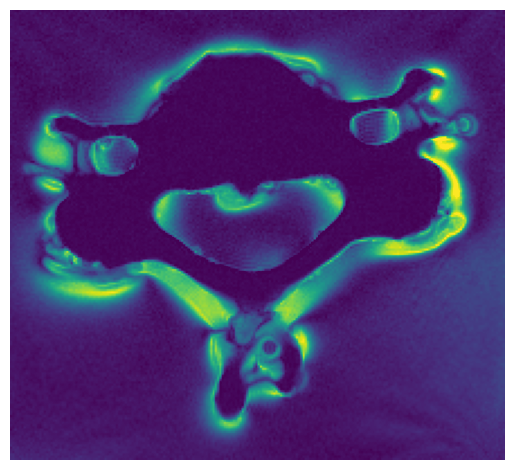

In [147]:
signal_loss_comp(sliceME=13, sigma=0.5)

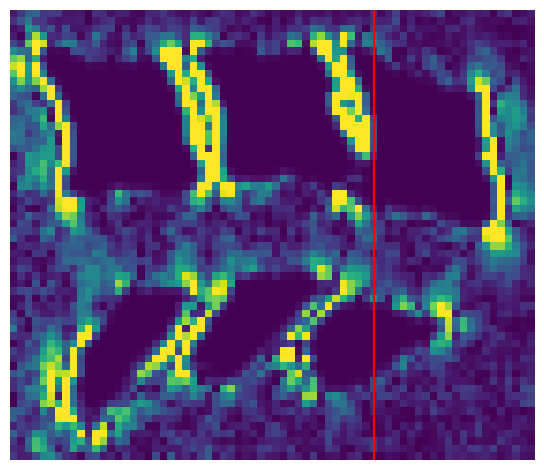

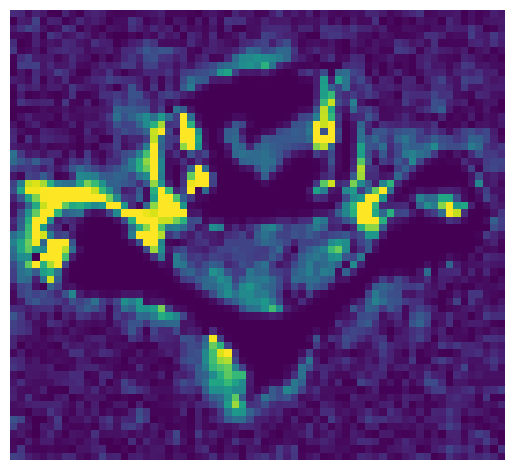

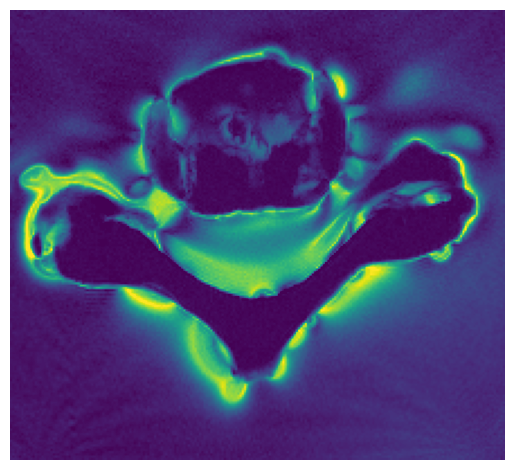

In [148]:
signal_loss_comp(sliceME=16, sigma=0.5)

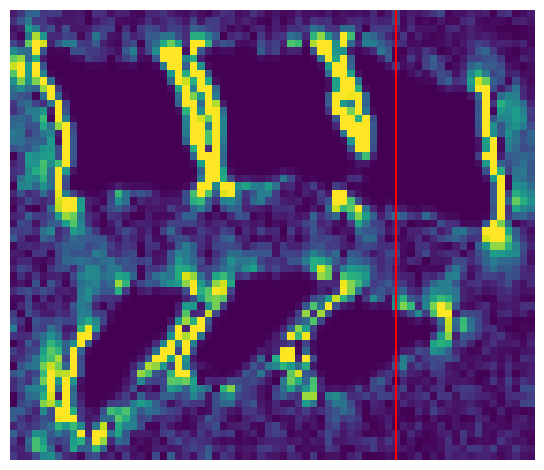

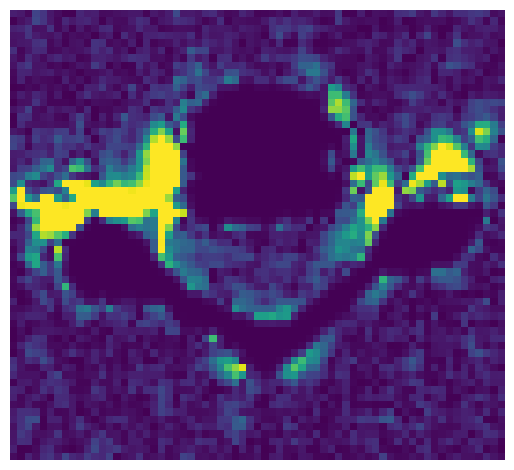

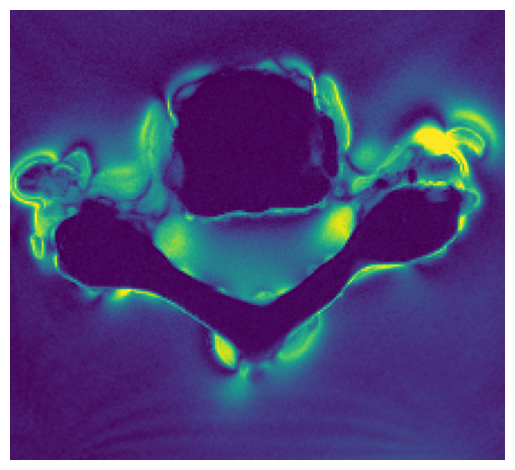

In [149]:
signal_loss_comp(sliceME=17, sigma=0.5)

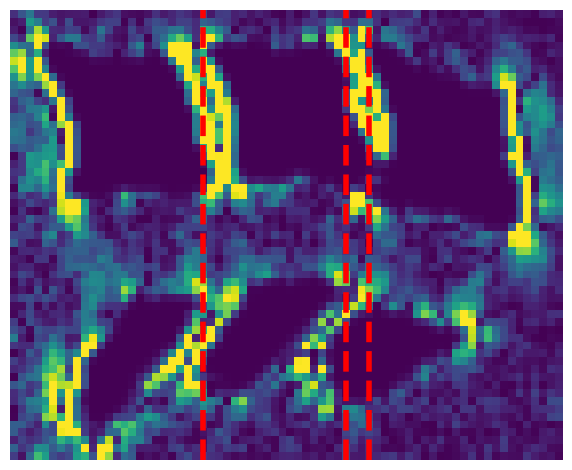

In [166]:
sliceME = np.array([8,14,15])
slice_fm = sliceME*3+6
signal_loss_fm_rotated = abs(gaussian_filter(signal_loss_fm1_rotated, sigma=0.5))

plt.figure()
plt.imshow(signal_loss_fm_rotated[11:68,40,6:76], vmin=-0, vmax=6)
for i in range (len(slice_fm)):
    plt.axvline(x=slice_fm[i]-6, c="r", linewidth = 4, linestyle = "--")
plt.axis('off')
plt.tight_layout()
# plt.savefig("figures/signal_loss_sagittal_multislices")

### T2* maps

(600, 576, 26)


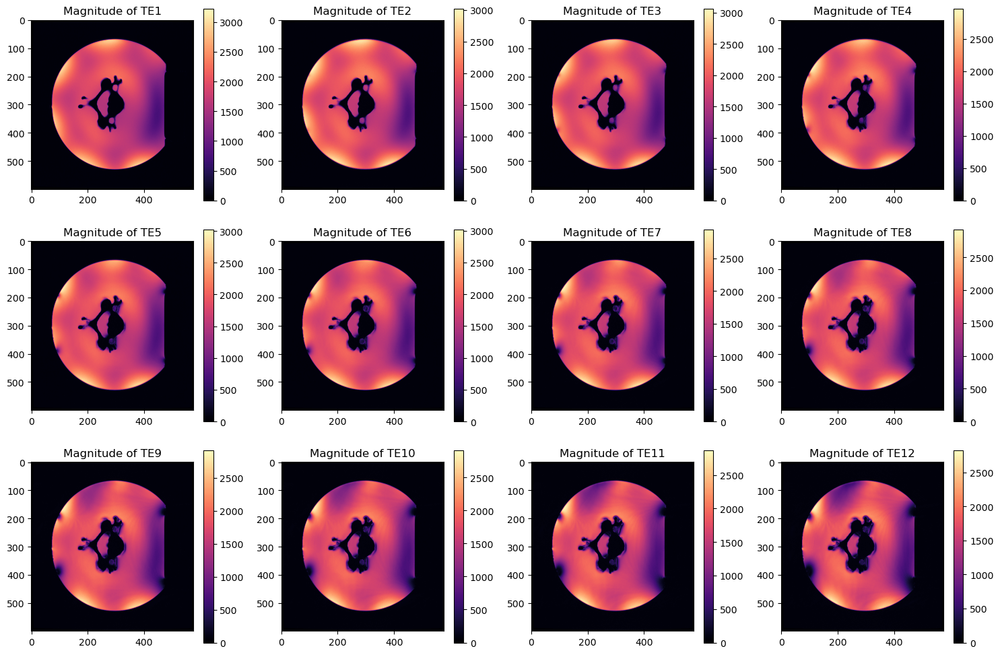

In [59]:
plt.figure('12TE', figsize=(15,10))

for i in range(len(mag_12TE)):
    plt.subplot(3,4,i+1)
    plt.imshow(mag_12TE[i][:,:,13] , cmap='magma')
    plt.colorbar()
    plt.title(f'Magnitude of TE{i+1}')

plt.tight_layout()

print(np.shape(mag_12TE[0]))
plt.show()


600 576 26
[1367.28273895  615.54307427]
R² = 0.8208201911789645
echo = 1367.2827389538388 * e^(-t/615.5430742702553)


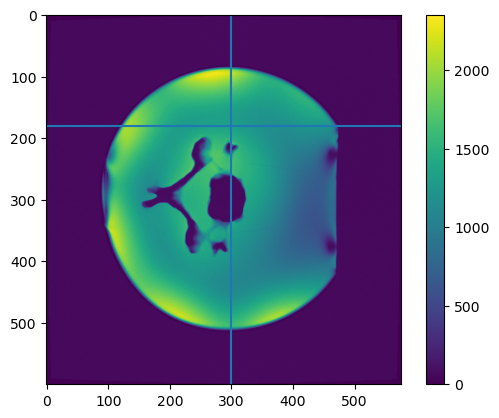

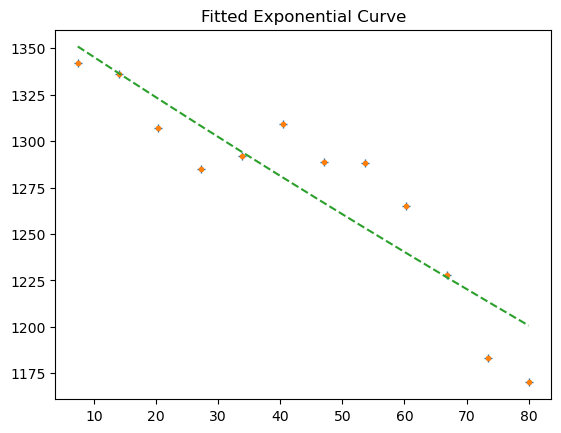

In [262]:
m,n,p = np.shape(mag_12TE[0])
print(m,n,p)
TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms

y, x, z = 180, 300, 5

echo = np.array([mag_12TE[i][y][x][int(z)] for i in range(12)])

plt.figure()
plt.imshow(mag_12TE[0][:,:,int(z)])
plt.axvline(x=x)
plt.axhline(y=y)
plt.colorbar()

plt.figure()
plt.plot(TE, echo, "+")
# print(mag_12TE[0][y][x][z])

def monoExp(t, A, T2_star):
    return A * np.exp(-t / T2_star) 

# perform the fit
p0 = (1, 1) # start with values near those we expect
params, cv = scipy.optimize.curve_fit(monoExp, TE, echo, bounds=(0, [10000, 3000]), maxfev=5000)
A, T2_star = params

print(params)
# determine quality of the fit
squaredDiffs = np.square(echo - monoExp(TE, A, T2_star))
squaredDiffsFromMean = np.square(echo - np.mean(echo))
rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)
print(f"R² = {rSquared}")

# plot the results
plt.plot(TE, echo, '.', label="data")
plt.plot(TE, monoExp(TE, A, T2_star), '--', label="fitted")
plt.title("Fitted Exponential Curve")

# inspect the parameters
print(f"echo = {A} * e^(-t/{T2_star})")


In [95]:
def T2_calcul(mag_12TE,y = 180, x=150, z=5, plot_and_print=True):
    '''
    Compute the $T_2^*$ and associated $R^2$ value in one voxel

    Parameters
    ----------
    mag_12TE : numpy.ndarray
        4D array of the magnitudes of the 12 echos.
    y : int, optional
        y coordinate of the voxel. The default is 180.
    x : int, optional
        x coordinate of the voxel. The default is 150.
    z : int, optional
        z coordinate of the voxel. The default is 5.
    plot_and_print : bool, optional
        if True, print the results and plot the selected voxel and the fit. the default is True.
    

    Returns
    -------
    (T2_star, rSquared) : tulle of int
        tulle of the $T_2^*$ and associated $R^2$ of the selected voxel.

    '''
    
    
    m,n,p = np.shape(mag_12TE[0])
    TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms
    echo = np.array([mag_12TE[i][y][x][int(z)] for i in range(12)])  #we first try t find the T2 value on one voxel

    def monoExp(t, A, T2_star, b):
        return A * np.exp(-t / T2_star) +b

    # perform the fit
    params, cv = scipy.optimize.curve_fit(monoExp, TE, echo, bounds=(0, [5000, 3000, 500]), maxfev=5000)
    A, T2_star, b = params

    # determine quality of the fit
    squaredDiffs = np.square(echo - monoExp(TE, A, T2_star, b))
    squaredDiffsFromMean = np.square(echo - np.mean(echo))
    rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)


    if plot_and_print == True:
        plt.figure()
        plt.imshow(mag_12TE[0][:,:,int(z)])
        plt.axvline(x=x)
        plt.axhline(y=y)
        plt.colorbar()

        plt.figure()
        plt.plot(TE, echo, "+")
        plt.plot(TE, monoExp(TE, A, T2_star, b), '--', label="fitted")
        plt.title("Fitted Exponential Curve")
        print(f'parameters = {params}')
        print(f"R² = {rSquared}")
    
        # inspect the parameters
        print(f"echo = {A} * e^(-t/{T2_star}) +{b}")
    
    return (T2_star, rSquared)

def calcT2_star_avg(mag_12TE,y, x, z, plot_and_print=True, radius=5, R_square_min = 0.8):
    '''
    Compute the averaged $T_2^*$ inside a circle for voxels and reject those with a low associated $R^2$.

    Parameters
    ----------
    mag_12TE : numpy.ndarray
        4D array of the magnitudes of the 12 echos.
    y : int
        y coordinate of the voxel. 
    x : int
        x coordinate of the voxel. 
    z : int
        z coordinate of the voxel. 
    plot_and_print : bool, optional
        if True, print the results and plot the selected circle. The default is True.
    radius : int
        radius of the circle
    R_square_min : float, optional
        minimum $R^2$ value to keep select a voxel. The default is 0.8.

    Returns
    -------
    (avg, std, len(T2_red)) : tulle of floats
        tulle of the mean, standard deviation of $T_2^*$ and number of selected voxels inside the circle

    '''
    
    T2_star_vec = []
    r_squarred_vec = []
    array_to_plot  = np.copy(mag_12TE[0])
    for i in range(radius*2):
        for j in range(radius*2):
            if (radius - i)**2+(radius-j)**2 < radius**2:
                T2_star, r_squ = T2_calcul(mag_12TE,y = y+radius-j, x=x+radius-i, z=z, plot_and_print=False)
                T2_star_vec.append(T2_star)
                r_squarred_vec.append(r_squ)
                array_to_plot[y+radius-j][x+radius-i][z] = 10000
    if plot_and_print == True:
        plt.figure()
        plt.imshow(array_to_plot[:,:,z])
    
    weights = (np.array(r_squarred_vec)>R_square_min) #we considere only the values that gave a sufficient R**2
    T2_red = [t for i, t in enumerate(T2_star_vec) if r_squarred_vec[i]>R_square_min ]
    
    
    avg = np.average(np.array(T2_star_vec), weights = weights)
    avg_ = np.average(np.array(T2_red))
    std=np.std(np.array(T2_red))
    print(f'weighted mean value of $T_2^* from numpy: {avg}')
    print(f'standard deviation value: {std}')
    print(f'number of values satisfying $R^2>R^2$: {len(T2_red)}')
    return(avg, std, len(T2_red))

weighted mean value of $T_2^* from numpy: 623.8310766660181
standard deviation value: 285.51003144953165
number of values satisfying $R^2>R^2$: 587


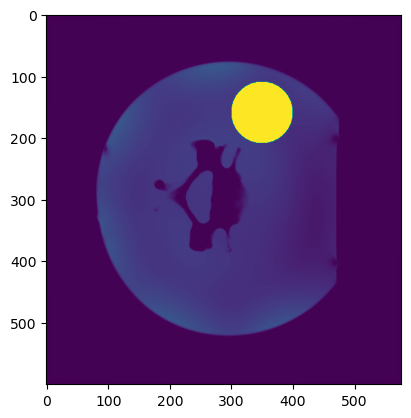

In [96]:
T2_avg, std, N = calcT2_star_avg(mag_12TE=mag_12TE,y = 159, x=350, z=8, plot_and_print=True, radius=50, R_square_min=0.9)

Due to high $T_2^*$ values, the fit is geenrating errors so we can't compute a  $T_2^*$ map

In [97]:
# m,n,p = np.shape(mag_12TE[0])
# T2_map = np.zeros((m,n,p))
# R_squarred_T2_map = np.zeros((m,n,p))

# TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms

# def monoExp(t, A, T2_star, b):
#     return A * np.exp(-t / T2_star) +b



# for i in tqdm.tqdm(range(m)):
#     for j in range(n):
#         for k in range(p):
#             echos = np.array([mag_12TE[eko][i][j][k] for eko in range(12)])
            
#             if echos[0]>750:
#                 # perform the fit
# #                 p0 = (1, 1) # start with values near those we expect
#                 params, cv = scipy.optimize.curve_fit(monoExp, TE, echos, maxfev=5000)#, p0)
#                 A, T2_star, b = params

#                 # determine quality of the fit
#                 squaredDiffs = np.square(echos - monoExp(TE, A, T2_star, b))
#                 squaredDiffsFromMean = np.square(echos - np.mean(echos))
#                 rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)

#                 R_squarred_T2_map[i][j][k] = rSquared
#                 T2_map[i][j][k] = T2_star
#             else:
# #                 R_squarred_T2_map[i][j][k] = 1
#                 T2_map[i][j][k] = 0

In [ ]:
# mag_12TE_reshaped = [rescaling_FOV(mag_12TE[i], x=250, y=294, z=13, dx=150, dy=160, dz=12) for i in range(12)]

# m,n,p = np.shape(mag_12TE_reshaped[0])
# T2_map2 = np.zeros((m,n,p))
# R_squarred_T2_map2 = np.zeros((m,n,p))

# TE = np.array([7.40, 14, 20.28, 27.20, 33.80, 40.4, 47, 53.6, 60.2, 66.8, 73.4, 80]) #ms

# plt.figure()
# plt.imshow(mag_12TE_reshaped[0][:,:,12])


# def monoExp(t, A, T2_star):
#     return A * np.exp(-t / T2_star) 



# for i in tqdm.tqdm(range(m)):
#     for j in range(n):
#         for k in range(p):
#             echos = np.array([mag_12TE_reshaped[eko][i][j][k] for eko in range(12)])
            
#             if echos[0]>750:
#                 # perform the fit
# #                 p0 = (0, 0) # start with values near those we expect
#                 params, cv = scipy.optimize.curve_fit(monoExp, TE, echos, maxfev=5000)#, p0)
#                 A, T2_star = params

#                 # determine quality of the fit
#                 squaredDiffs = np.square(echos - monoExp(TE, A, T2_star))
#                 squaredDiffsFromMean = np.square(echos - np.mean(echos))
#                 rSquared = 1 - np.sum(squaredDiffs) / np.sum(squaredDiffsFromMean)

#                 R_squarred_T2_map2[i][j][k] = rSquared
#                 T2_map2[i][j][k] = T2_star
#             else:
#                 R_squarred_T2_map2[i][j][k] = 1
#                 T2_map2[i][j][k] = 0